# Libraries

In [1]:
!pip install opencv-python==4.5.5.62
!pip install opencv-contrib-python==4.5.5.62
!pip install tf-explain

     |████████████████████████████████| 60.4 MB 55 kB/s             
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.5.4.60
    Uninstalling opencv-python-4.5.4.60:
      Successfully uninstalled opencv-python-4.5.4.60
     |████████████████████████████████| 66.6 MB 204 kB/s            
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.5.4.60
    Uninstalling opencv-contrib-python-4.5.4.60:
      Successfully uninstalled opencv-contrib-python-4.5.4.60
     |████████████████████████████████| 43 kB 1.6 MB/s             


In [2]:
import os
import gc
import sys

import pandas as pd
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import skimage
from skimage.feature import hog, canny
from skimage.filters import sobel
from skimage import color

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split

from keras import layers
import keras.backend as K
from keras.models import Sequential, Model
from keras.preprocessing import image
from keras.layers import Input, Dense, Activation, Dropout
from keras.layers import Flatten, BatchNormalization, Conv2D
from keras.layers import MaxPooling2D, AveragePooling2D, GlobalAveragePooling2D 
from keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications import ResNet50
from tf_explain.core.activations import ExtractActivations
from tf_explain.core.grad_cam import GradCAM

from PIL import Image
from tqdm import tqdm
import random as rnd
import cv2
from keras.preprocessing.image import ImageDataGenerator
from numpy import expand_dims

!pip install livelossplot
from livelossplot import PlotLossesKeras

%matplotlib inline

# Loading Dataset
We'll use here the Pandas to load the dataset into memory

In [3]:
main_path = 'images/'

In [4]:
main_df = pd.read_csv('train.csv')

In [5]:
paths = os.listdir(main_path)

In [6]:
main_df['path'] = main_path + main_df['image']

In [7]:
categories = list(main_df['category'])
categorys = {1:'Cargo', 2:'Military', 3:'Carrier', 4:'Cruise', 5:'Tankers'}
classes = []

In [8]:
for category in categories:
    classes.append(categorys[category])

In [9]:
main_df['classes'] = classes

In [10]:
main_df.head()

,image,category,path,classes
0,2823080.jpg,1,../input/game-of-deep-learning-ship-datasets/t...,Cargo
1,2870024.jpg,1,../input/game-of-deep-learning-ship-datasets/t...,Cargo
2,2662125.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military
3,2900420.jpg,3,../input/game-of-deep-learning-ship-datasets/t...,Carrier
4,2804883.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military


In [11]:
test_df = pd.read_csv('test_ApKoW4T.csv')

In [12]:
test_df['path'] = main_path + test_df['image']

# Analyzing counts

In [13]:
print('Train samples: ', len(main_df))
print('Test samples: ', len(test_df))

Train samples:  6252
Test samples:  2680


# Glimpses of Dataset

## Main Dataset

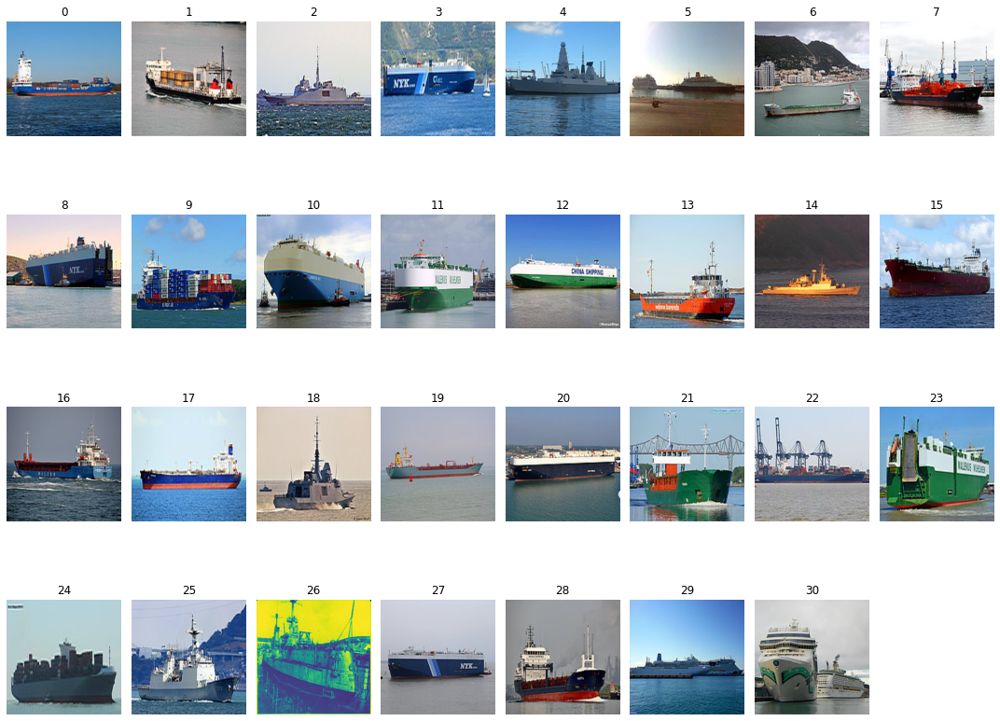

In [14]:
plt.figure(figsize = (15,12))
for idx,image_path in enumerate(main_df['path']):
    if idx==31:
        break
    plt.subplot(4,8,idx+1)
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(idx)
plt.tight_layout()
plt.show()

## Test Dataset

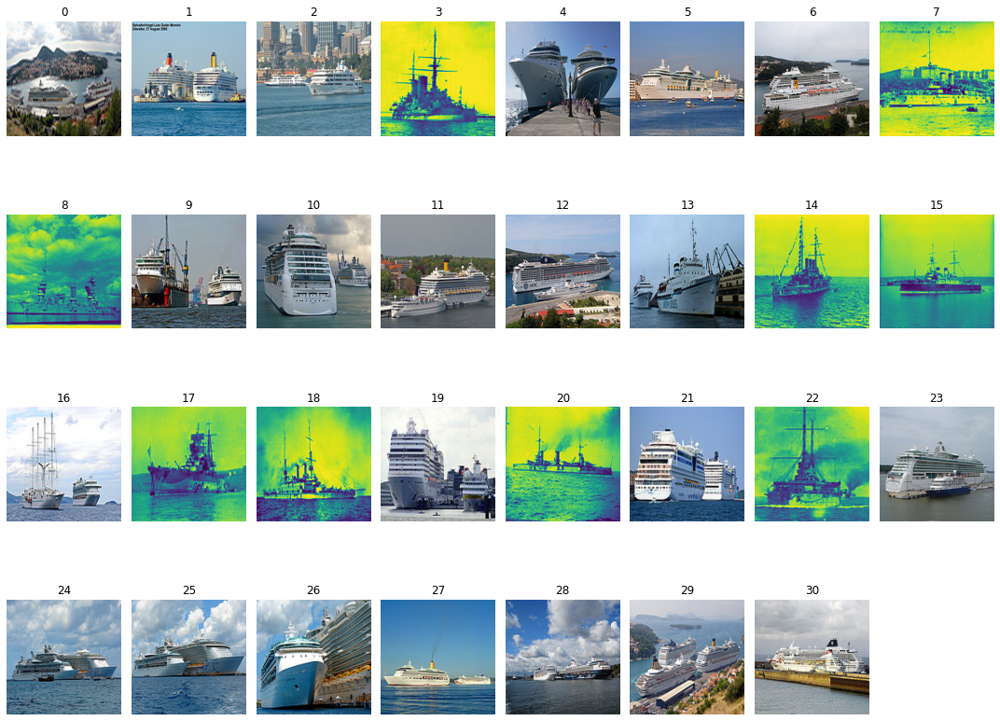

In [15]:
plt.figure(figsize = (15,12))
for idx,image_path in enumerate(test_df['path']):
    if idx==31:
        break
    plt.subplot(4,8,idx+1)
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(idx)
plt.tight_layout()
plt.show()

## Counts of Ships Categories

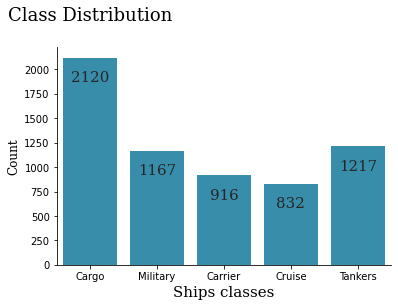

In [16]:
plot = sns.countplot(x = main_df['classes'], color = '#2596be')
sns.set(rc={'figure.figsize':(15,12)})
sns.despine()
plot.set_title('Class Distribution\n', font = 'serif', x = 0.1, y=1, fontsize = 18);
plot.set_ylabel("Count", x = 0.02, font = 'serif', fontsize = 12)
plot.set_xlabel("Ships classes", fontsize = 15, font = 'serif')

for p in plot.patches:
    plot.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2, p.get_height()), 
       ha = 'center', va = 'center', xytext = (0, -20),font = 'serif', textcoords = 'offset points', size = 15)

## Image Resolutions

In [17]:
widths, heights = [], []

for path in tqdm(main_df["path"]):
    width, height = Image.open(path).size
    widths.append(width)
    heights.append(height)
    
main_df["width"] = widths
main_df["height"] = heights
main_df["dimension"] = main_df["width"] * main_df["height"]

100%|██████████| 6252/6252 [00:22<00:00, 282.73it/s]


**Lets see some small images**

In [18]:
main_df.sort_values('width').head(84)

,image,category,path,classes,width,height,dimension
2766,2833376.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,91,158,14378
3182,2825824.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,96,158,15168
3186,1124952.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,100,158,15800
2732,2855931.jpg,5,../input/game-of-deep-learning-ship-datasets/t...,Tankers,105,158,16590
1576,914599.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,105,158,16590
...,...,...,...,...,...,...,...
3295,1923069.jpg,4,../input/game-of-deep-learning-ship-datasets/t...,Cruise,192,158,30336
1613,2809866.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,192,158,30336
2840,2849133.jpg,3,../input/game-of-deep-learning-ship-datasets/t...,Carrier,192,158,30336
3672,2777434.jpg,4,../input/game-of-deep-learning-ship-datasets/t...,Cruise,192,158,30336


**Let see some large images**

In [19]:
main_df.sort_values('width', ascending = False).head(84)

,image,category,path,classes,width,height,dimension
0,2823080.jpg,1,../input/game-of-deep-learning-ship-datasets/t...,Cargo,210,140,29400
4268,2566396.jpg,4,../input/game-of-deep-learning-ship-datasets/t...,Cruise,210,140,29400
4142,2849919.jpg,1,../input/game-of-deep-learning-ship-datasets/t...,Cargo,210,126,26460
4141,2868004.jpg,5,../input/game-of-deep-learning-ship-datasets/t...,Tankers,210,140,29400
4140,2783824.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,210,152,31920
...,...,...,...,...,...,...,...
4111,2856008.jpg,1,../input/game-of-deep-learning-ship-datasets/t...,Cargo,210,157,32970
4110,2438564.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,210,140,29400
4109,2713013.jpg,2,../input/game-of-deep-learning-ship-datasets/t...,Military,210,140,29400
4108,2888369.jpg,1,../input/game-of-deep-learning-ship-datasets/t...,Cargo,210,140,29400


In [20]:
main_df.mean()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


category         2.657550
width          209.056302
height         138.979687
dimension    29036.629878
dtype: float64

# Color Analysis
We need to do some color analysis to get an ida about the augmentation technique needed for this problem

In [21]:
def is_grey_scale(givenImage):
    w,h = givenImage.size
    for i in range(w):
        for j in range(h):
            r,g,b = givenImage.getpixel((i,j))
            if r != g != b: return False
    return True

**Check color scale of Train images**

In [22]:
sampleFrac = 0.4
#get our sampled images
isGreyList = []
for imageName in main_df['path'].sample(frac=sampleFrac):
    val = Image.open(imageName).convert('RGB')
    isGreyList.append(is_grey_scale(val))
print(np.sum(isGreyList) / len(isGreyList))
del isGreyList

0.026389444222311077


**Check color scale of Test images**

In [23]:
sampleFrac = 0.4
#get our sampled images
isGreyList_test = []
for imageName in test_df['path'].sample(frac=sampleFrac):
    val = Image.open(imageName).convert('RGB')
    isGreyList_test.append(is_grey_scale(val))
print(np.sum(isGreyList_test) / len(isGreyList_test))
del isGreyList_test

0.04011194029850746


**Get mean intensity for each channel RGB**

In [24]:
def get_rgb_men(row):
    img = cv2.imread(row['path'])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return np.sum(img[:,:,0]), np.sum(img[:,:,1]), np.sum(img[:,:,2])

tqdm.pandas()
main_df['R'], main_df['G'], main_df['B'] = zip(*main_df.progress_apply(lambda row: get_rgb_men(row), axis=1))

100%|██████████| 6252/6252 [00:10<00:00, 592.50it/s]


In [25]:
def show_color_dist(df, count):
    fig, axr = plt.subplots(count,2,figsize=(15,15))
    if df.empty:
        print("Image internsity of selected color is weak")
        return
    for idx, i in enumerate(np.random.choice(df['path'], count)):
        img = cv2.imread(i)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axr[idx,0].imshow(img)
        axr[idx,0].axis('off')
        axr[idx,1].set_title('R={:.0f}, G={:.0f}, B={:.0f} '.format(np.mean(img[:,:,0]), np.mean(img[:,:,1]), np.mean(img[:,:,2]))) 
        x, y = np.histogram(img[:,:,0], bins=255)
        axr[idx,1].bar(y[:-1], x, label='R', alpha=0.8, color='red')
        x, y = np.histogram(img[:,:,1], bins=255)
        axr[idx,1].bar(y[:-1], x, label='G', alpha=0.8, color='green')
        x, y = np.histogram(img[:,:,2], bins=255)
        axr[idx,1].bar(y[:-1], x, label='B', alpha=0.8, color='blue')
        axr[idx,1].legend()
        axr[idx,1].axis('off')

## Red images and their color distribution
Since we are picking random images, some image may appear multiple times

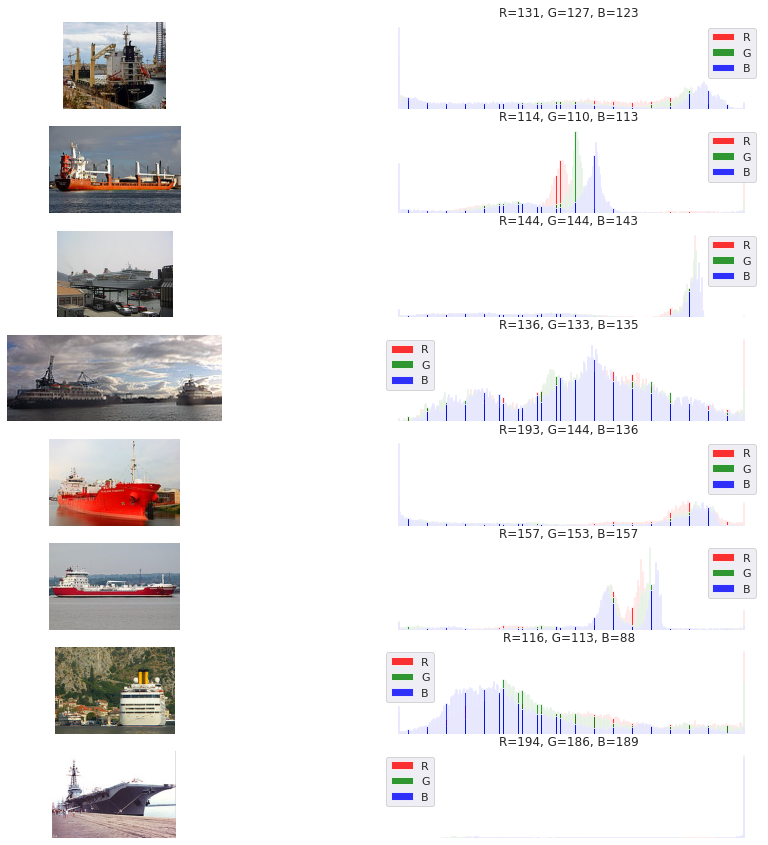

In [26]:
df = main_df[((main_df['B']) < main_df['R']) & ((main_df['G']) < main_df['R'])]
show_color_dist(df, 8)

## Green images and their color distribution
Since we are picking random images, some image may appear multiple times

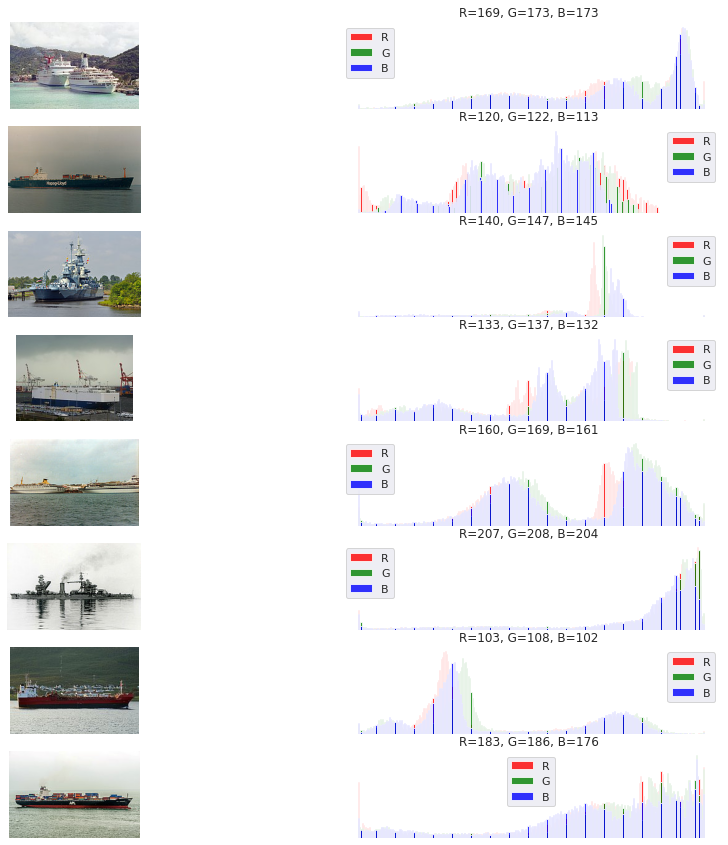

In [27]:
df = main_df[(main_df['G'] > main_df['R']) & (main_df['G'] > main_df['B'])]
show_color_dist(df, 8)

## Blue images and their color distribution
Since we are picking random images, some image may appear multiple times

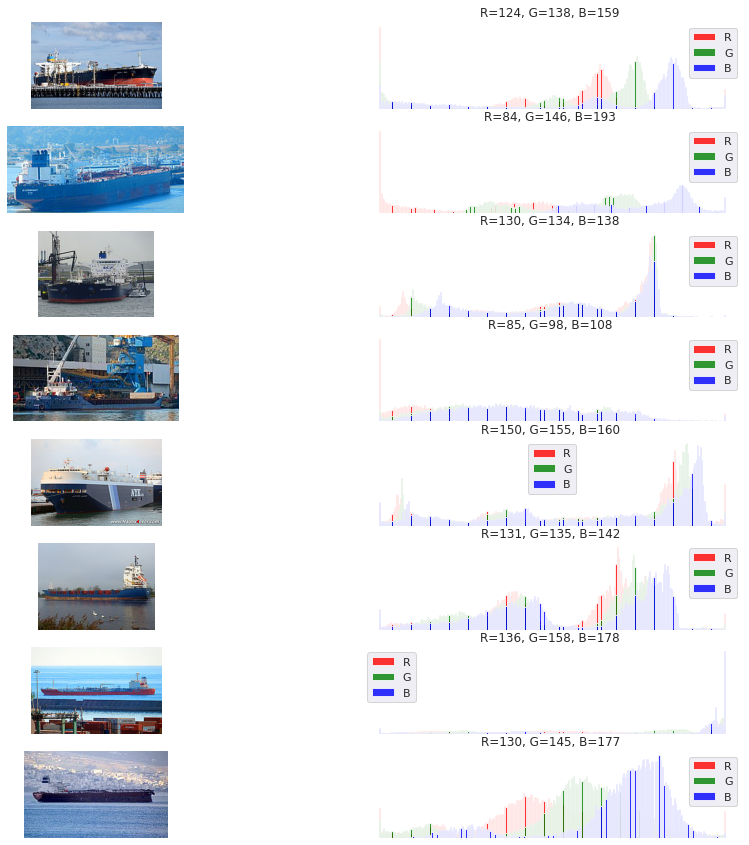

In [28]:
df = main_df[(main_df['B'] > main_df['R']) & (main_df['B'] > main_df['G'])]
show_color_dist(df, 8)

# Feature

## Analyzing Edges
A Sobel filter is one means of getting a basic edge magnitude/gradient image. Can be useful to threshold and find prominent linear features, etc. Several other similar filters in skimage.filters are also good edge detectors: roberts, scharr, etc. and you can control direction, i.e. use an anisotropic version.

In [29]:
def edges_images_gray(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        edges = sobel(image)
        gray_edges=canny(gray)
        dimension = edges.shape
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(gray_edges)
        plt.subplot(2,2,2)
        plt.imshow(edges[:dimension[0],:dimension[1],0], cmap="gray")
        plt.subplot(2,2,3)
        plt.imshow(edges[:dimension[0],:dimension[1],1], cmap='gray')
        plt.subplot(2,2,4)
        plt.imshow(edges[:dimension[0],:dimension[1],2], cmap='gray')
        plt.show()

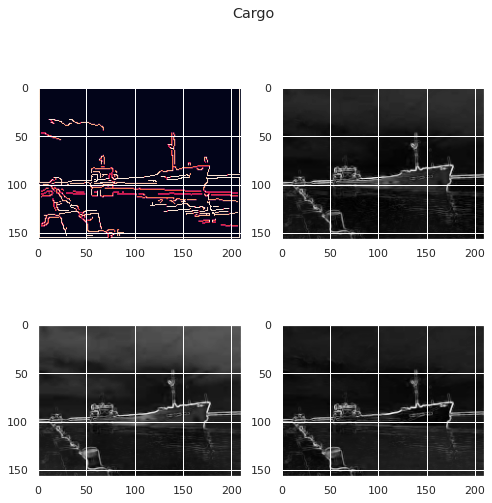

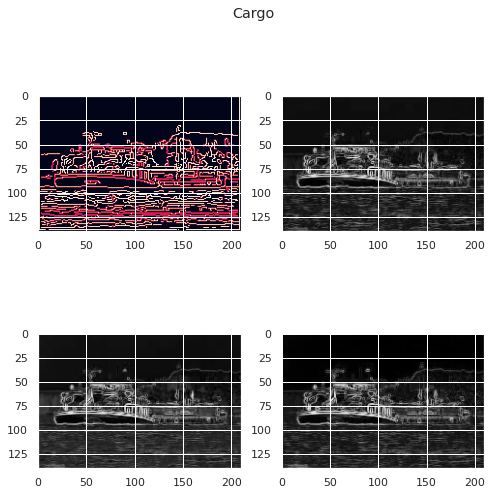

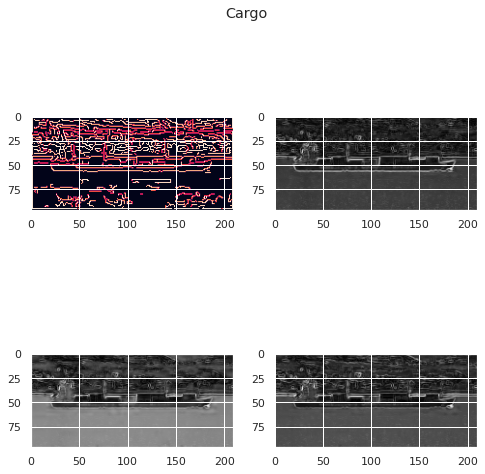

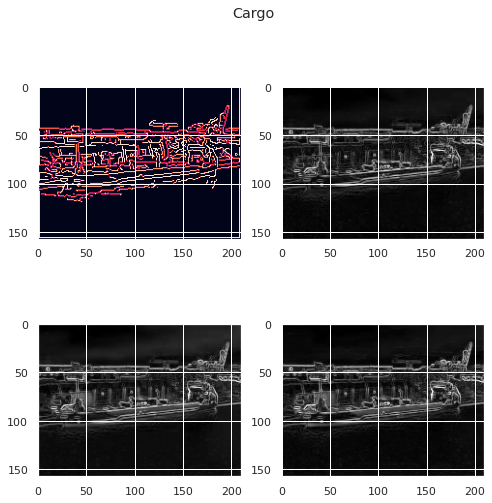

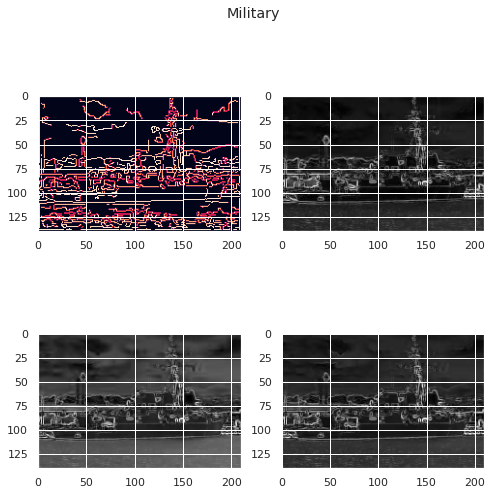

...

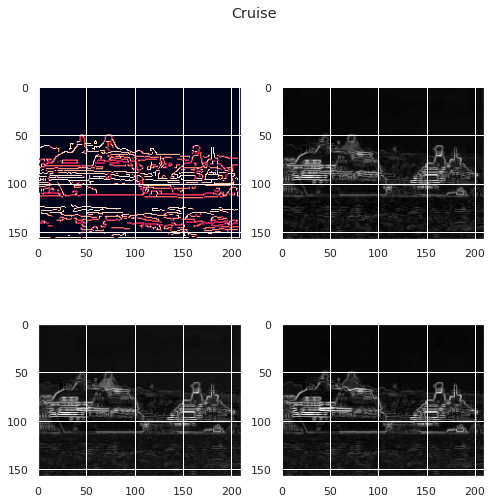

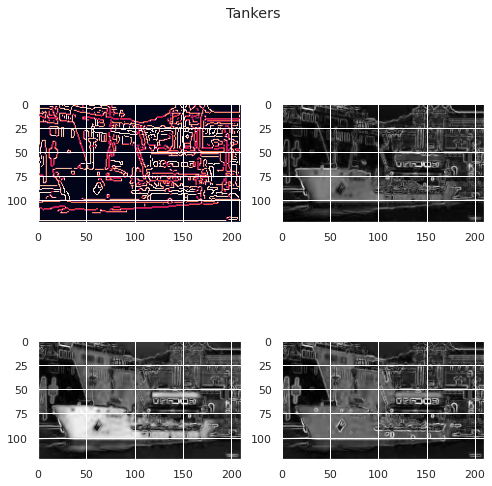

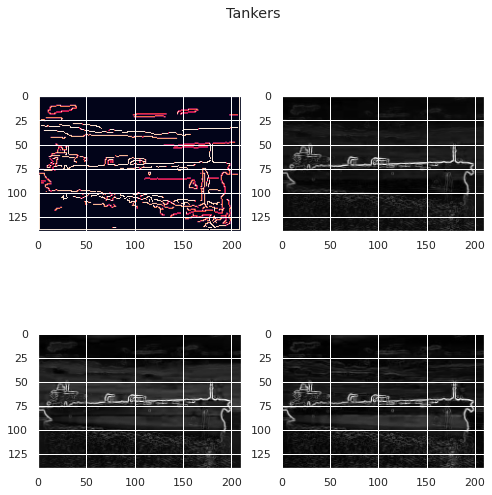

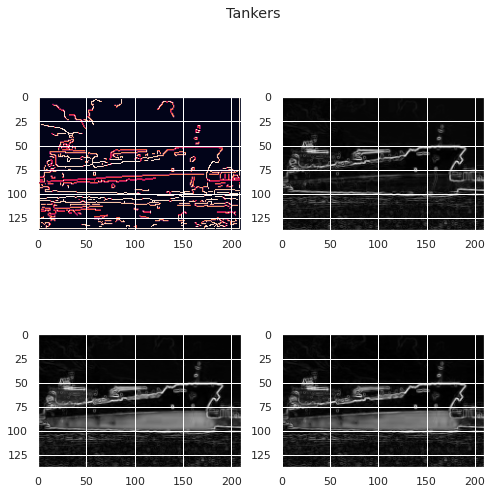

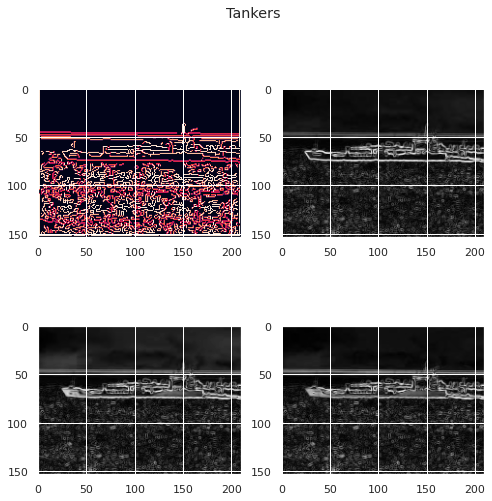

In [30]:
for class_name in main_df['classes'].unique():
    edges_images_gray(class_name)

## HSV Transform
Since this contest is about time series ordering, I think it's possible there may be useful information in a transform to HSV color space. HSV is useful for identifying shadows and illumination, as well as giving us a means to identify similar objects that are distinct by color between scenes (hue), though there's no guarantee the hue will be stable.

In [31]:
def hsv_images(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):  
        image = cv2.imread(i)
        hsv = color.rgb2hsv(image)
        dimension = hsv.shape
        fig = plt.figure(figsize=(8, 8))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(image)
        plt.subplot(2,2,2)
        plt.imshow(hsv[:dimension[0],:dimension[1],0], cmap="PuBuGn")
        plt.subplot(2,2,3)
        plt.imshow(hsv[:dimension[0],:dimension[1],1], cmap='PuBuGn')
        plt.subplot(2,2,4)
        plt.imshow(hsv[:dimension[0],:dimension[1],2], cmap='PuBuGn')
        plt.show()

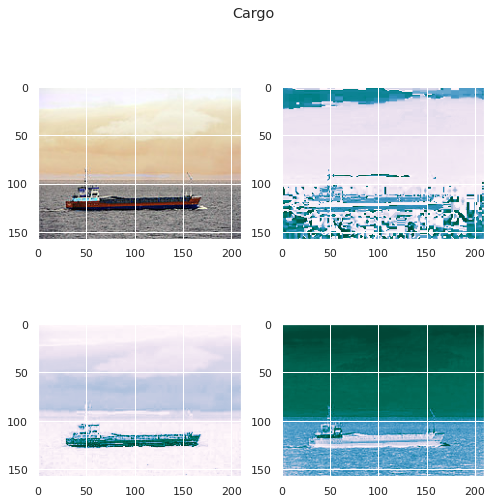

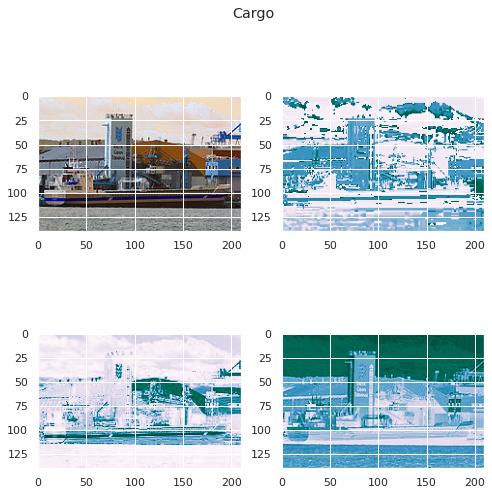

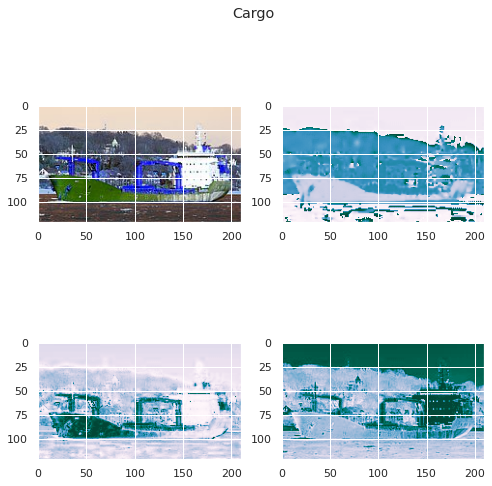

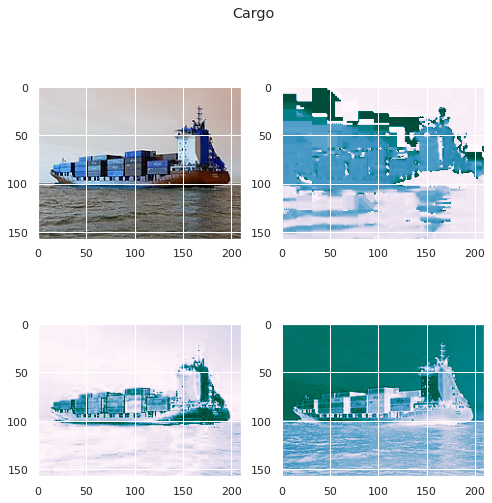

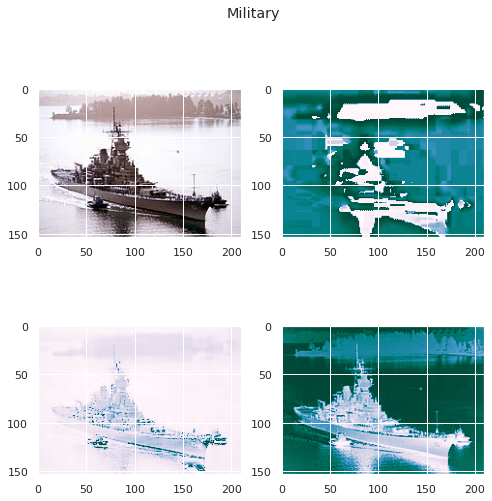

...

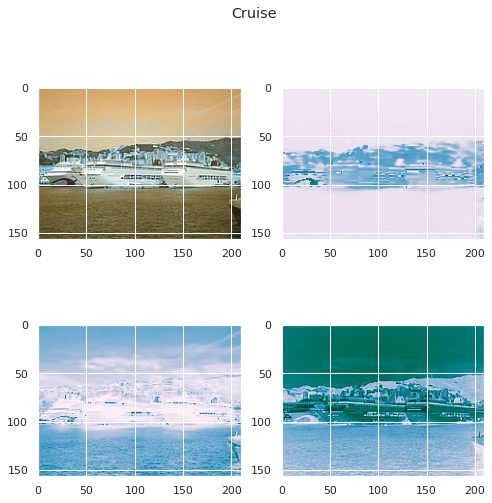

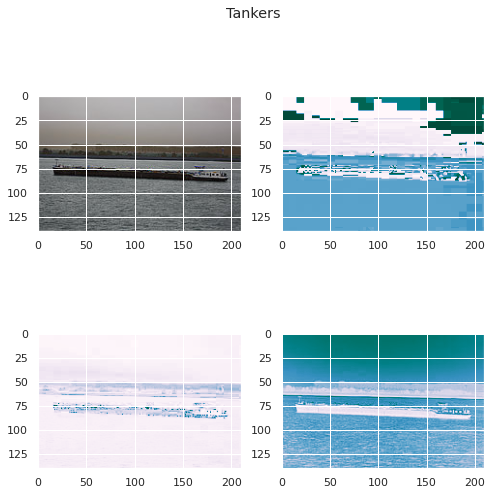

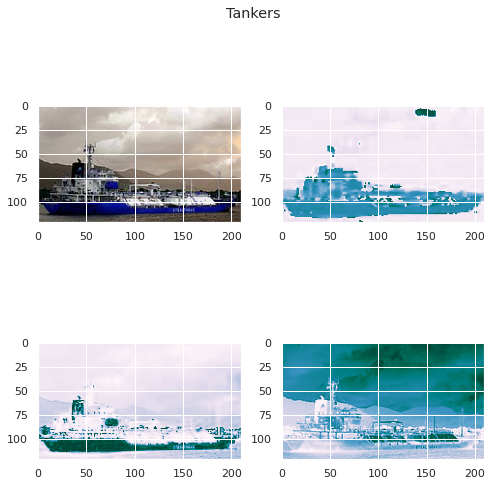

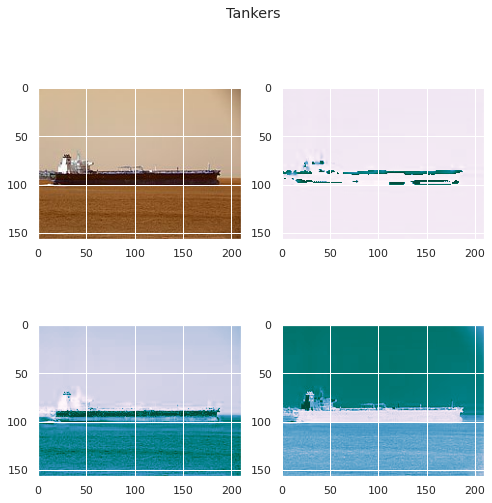

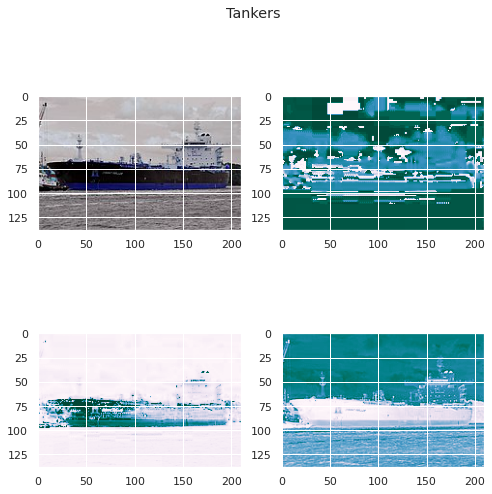

In [32]:
for class_name in main_df['classes'].unique():
    hsv_images(class_name)

## Corners

In [33]:
def corners_images_gray(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        corners_gray = cv2.goodFeaturesToTrack(gray, maxCorners=50, qualityLevel=0.02, minDistance=20)
        corners_gray = np.float32(corners_gray)
        for item in corners_gray:
            x, y = item[0]
            cv2.circle(image, (int(x), int(y)), 6, (0, 255, 0), -1)
        fig = plt.figure(figsize=(32, 32))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(image, cmap="BuGn")
        plt.show()

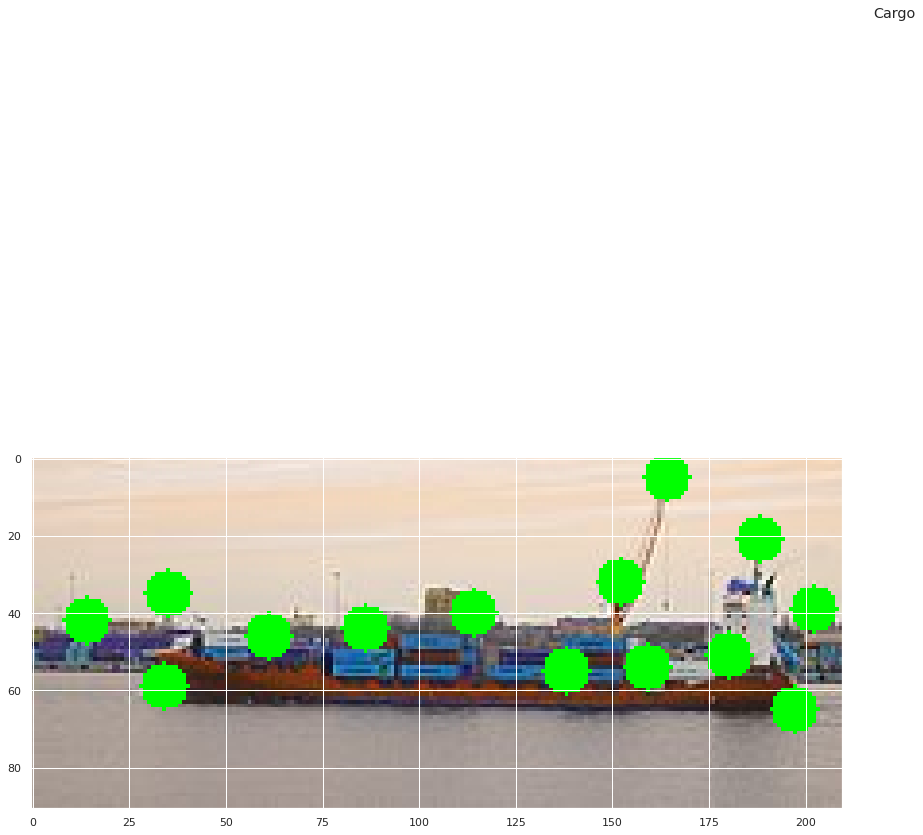

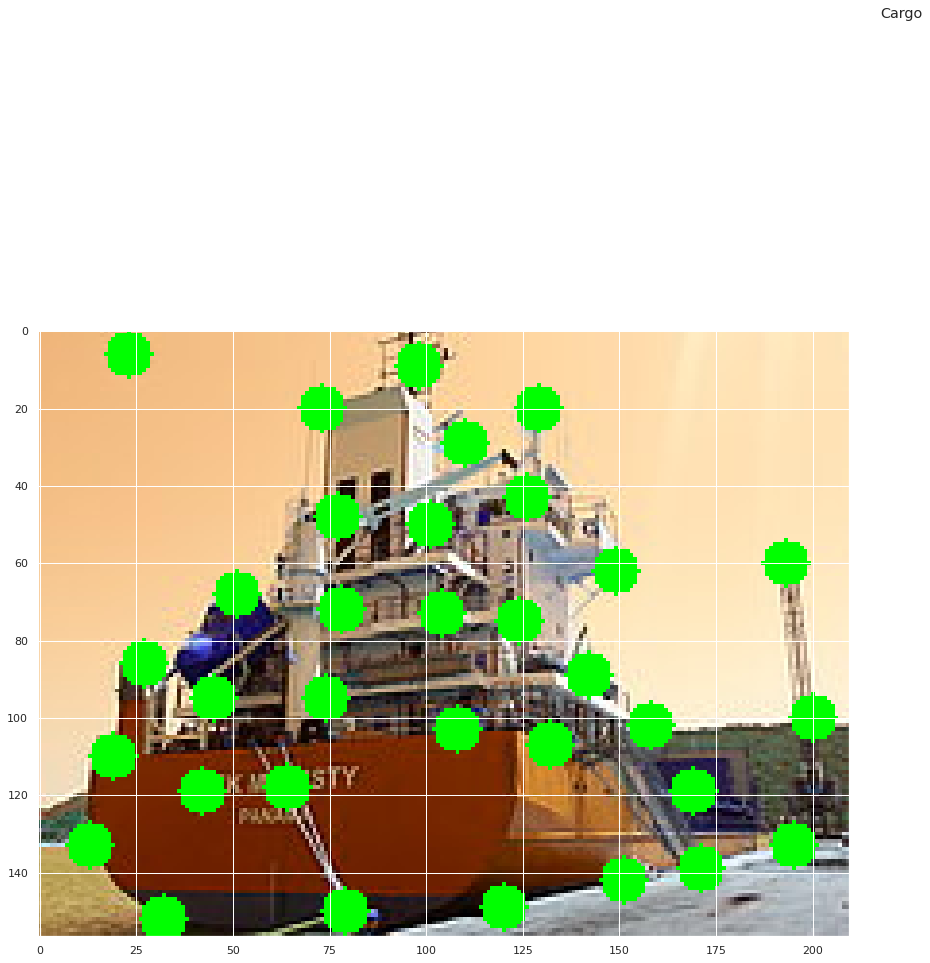

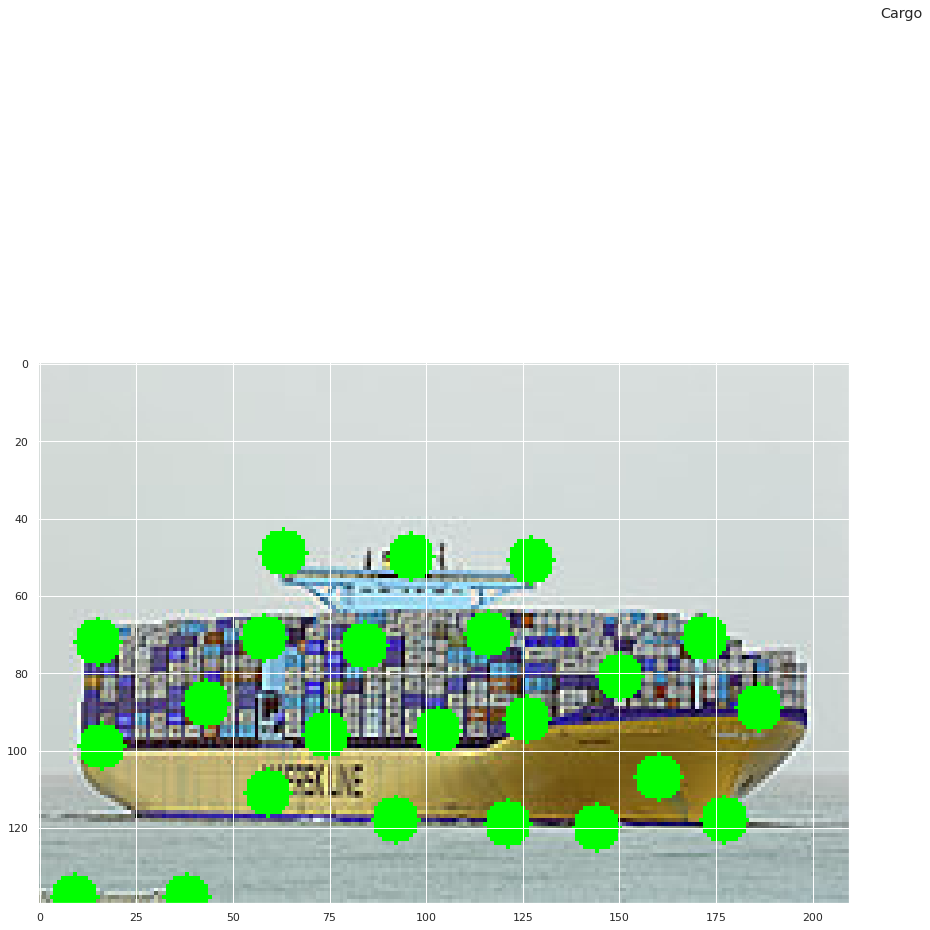

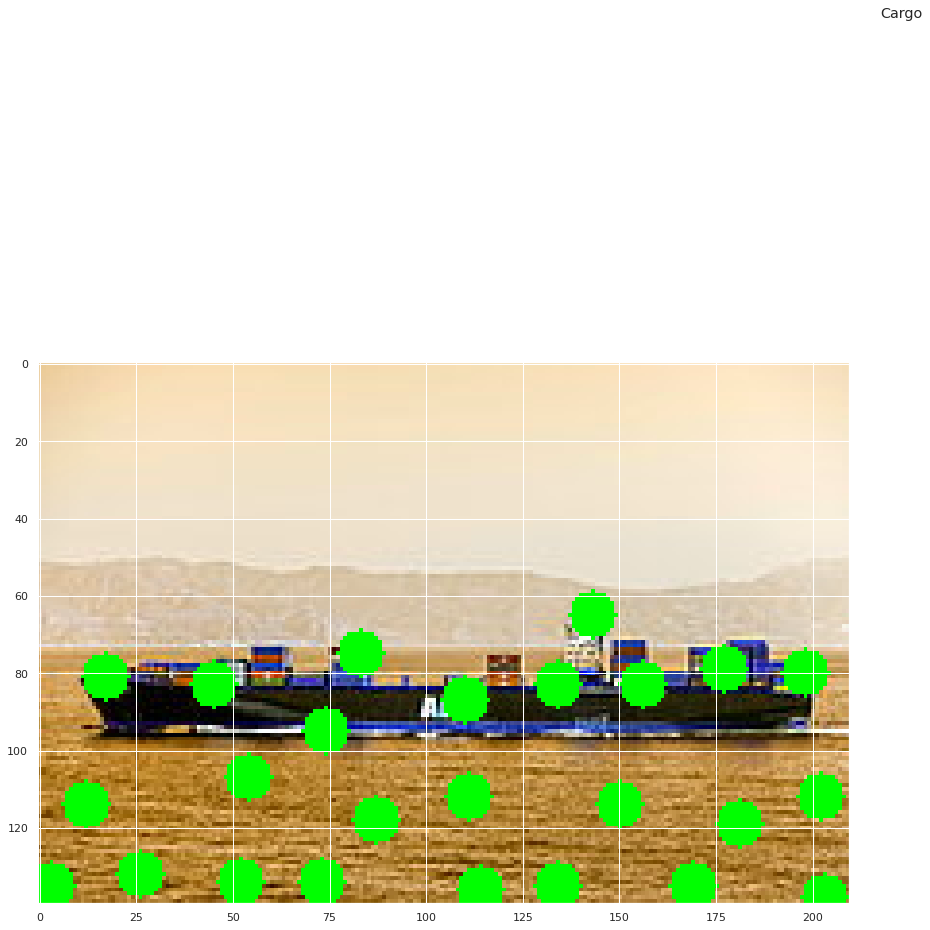

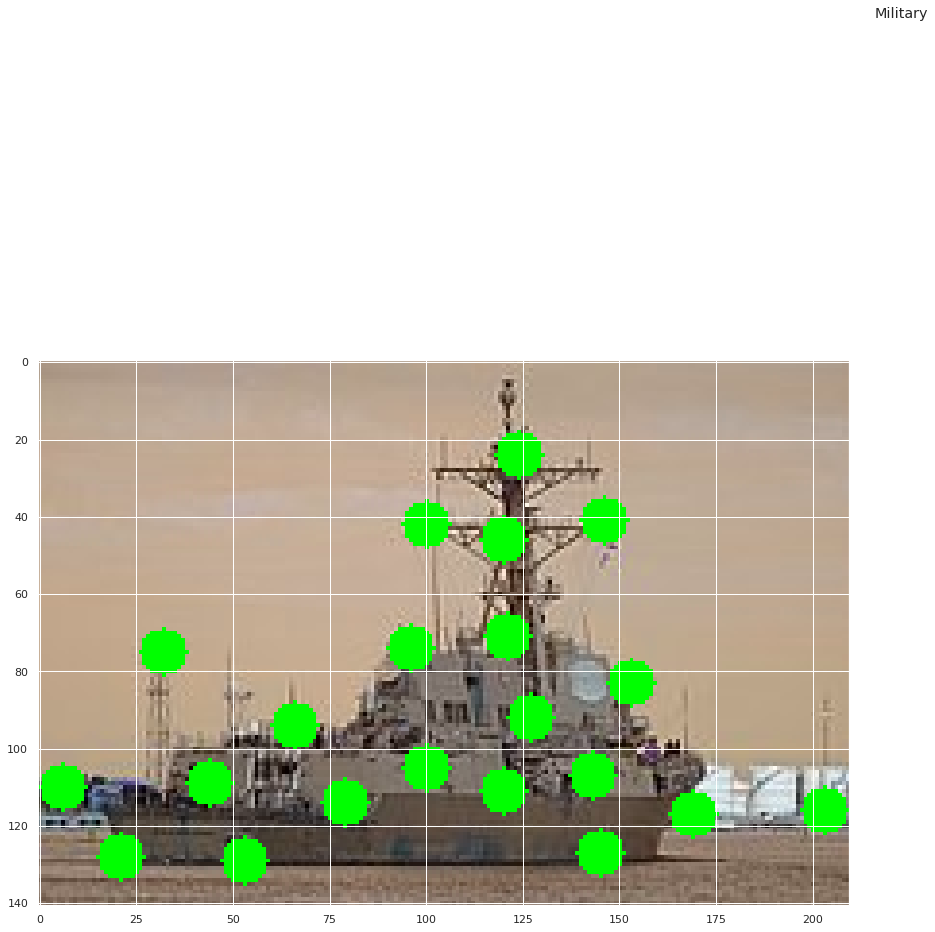

...

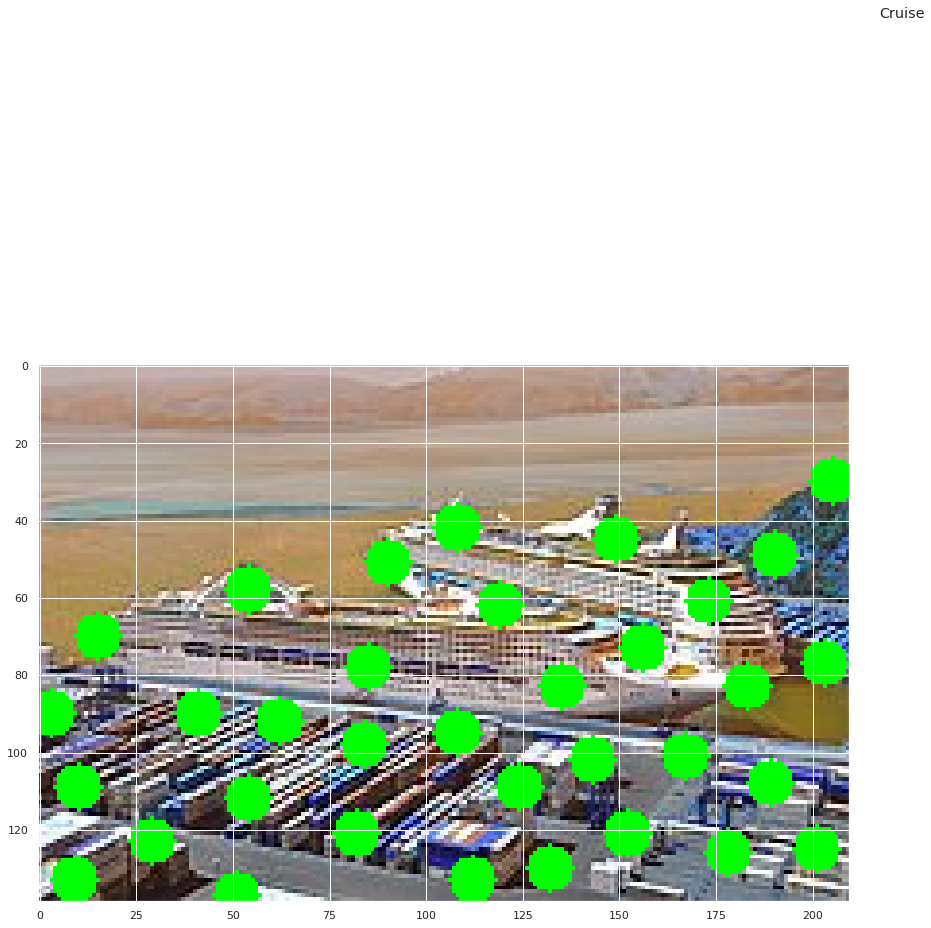

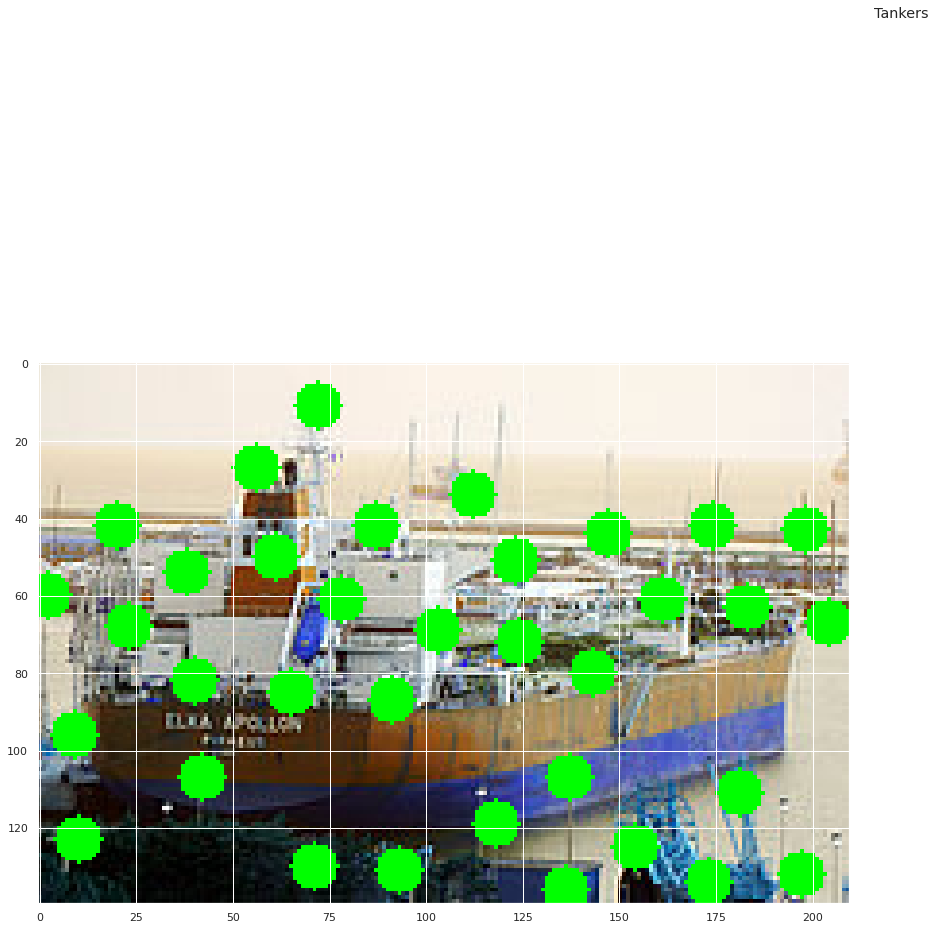

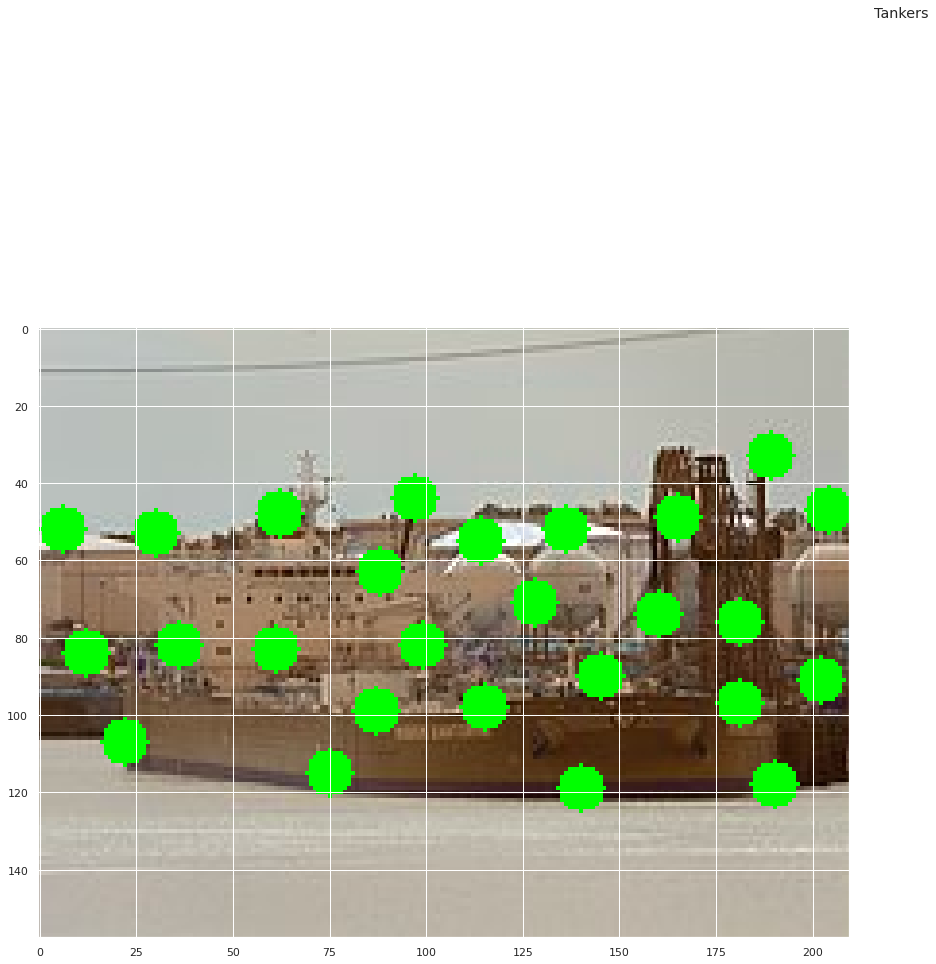

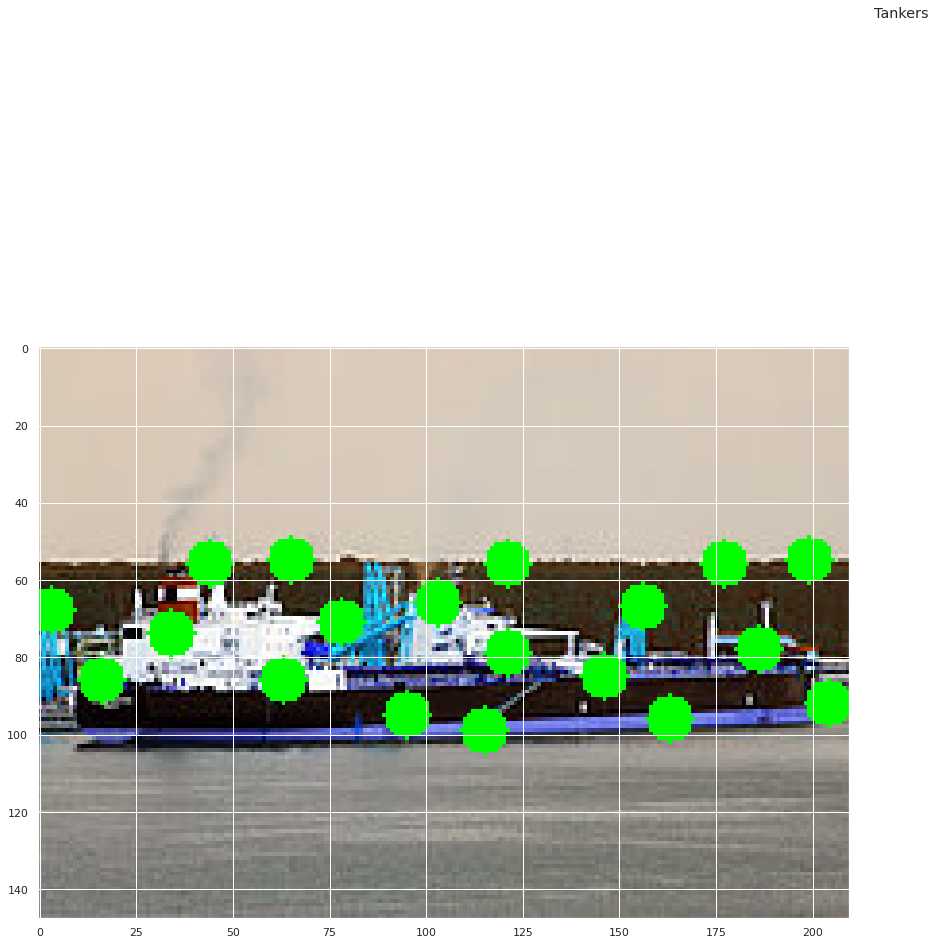

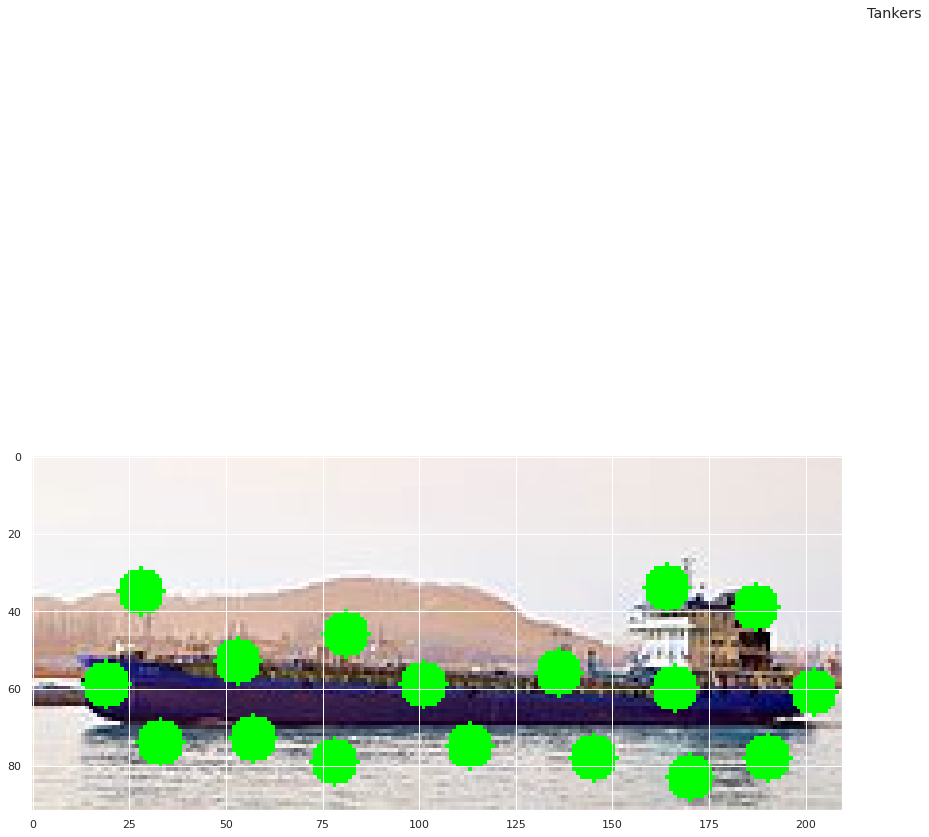

In [34]:
for class_name in main_df['classes'].unique():
    corners_images_gray(class_name)

## Sift Features

In [35]:
def sift_images_gray(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sift = cv2.SIFT_create()
        kp, des = sift.detectAndCompute(gray, None)
        kp_img = cv2.drawKeypoints(image, kp, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        fig = plt.figure(figsize=(32, 32))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(kp_img, cmap="viridis")
        plt.show()

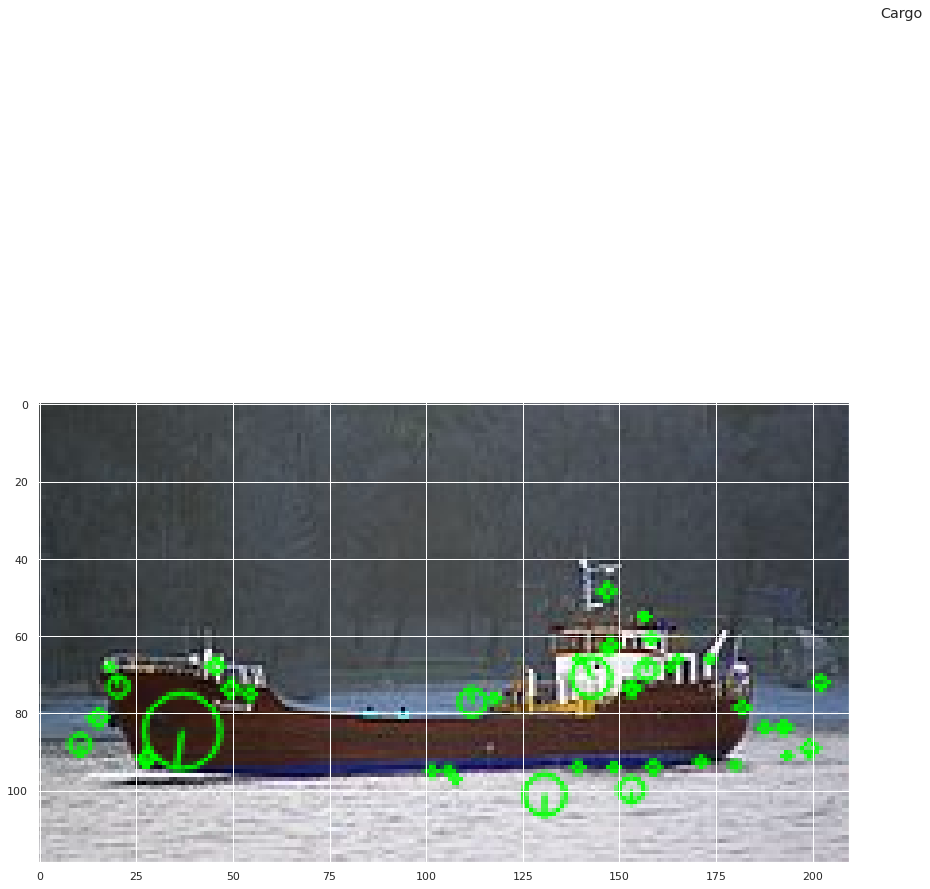

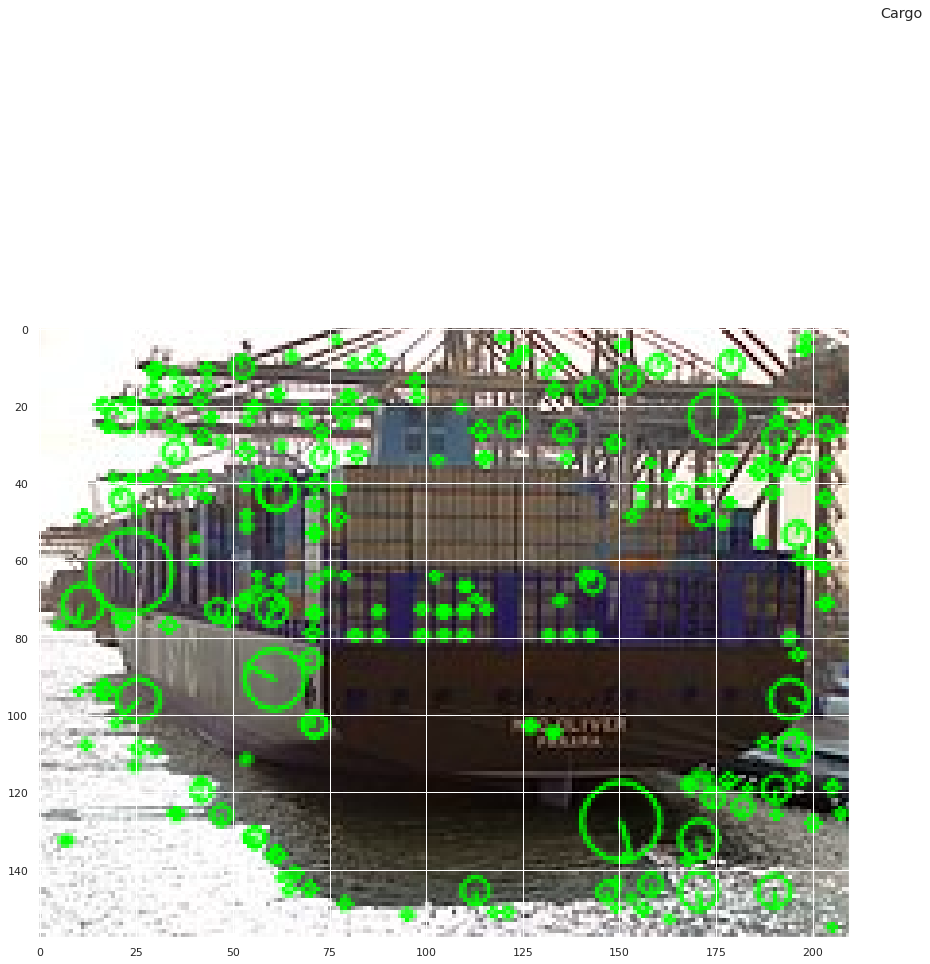

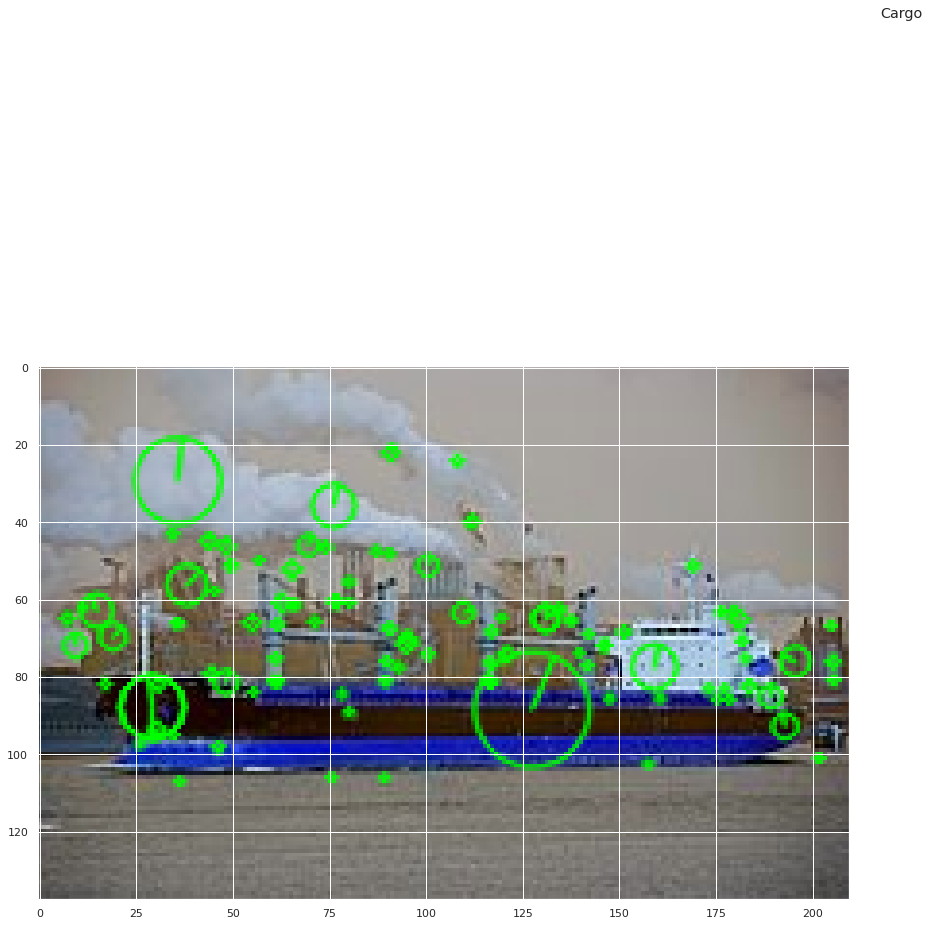

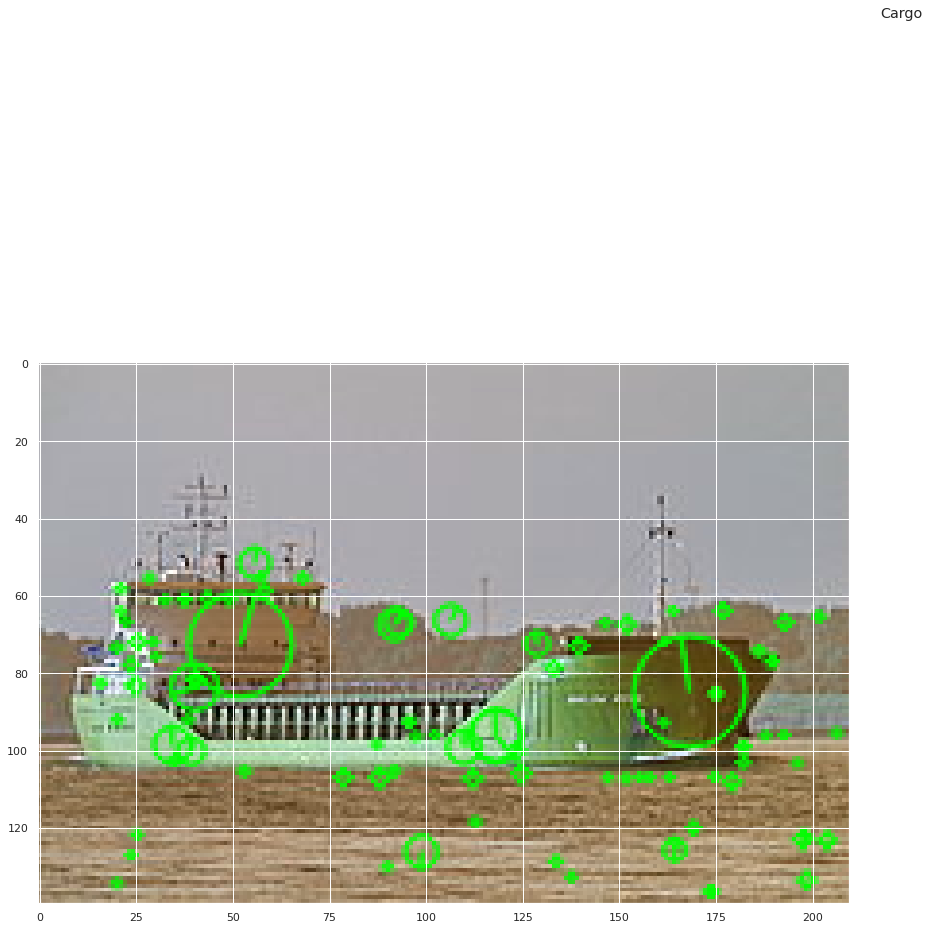

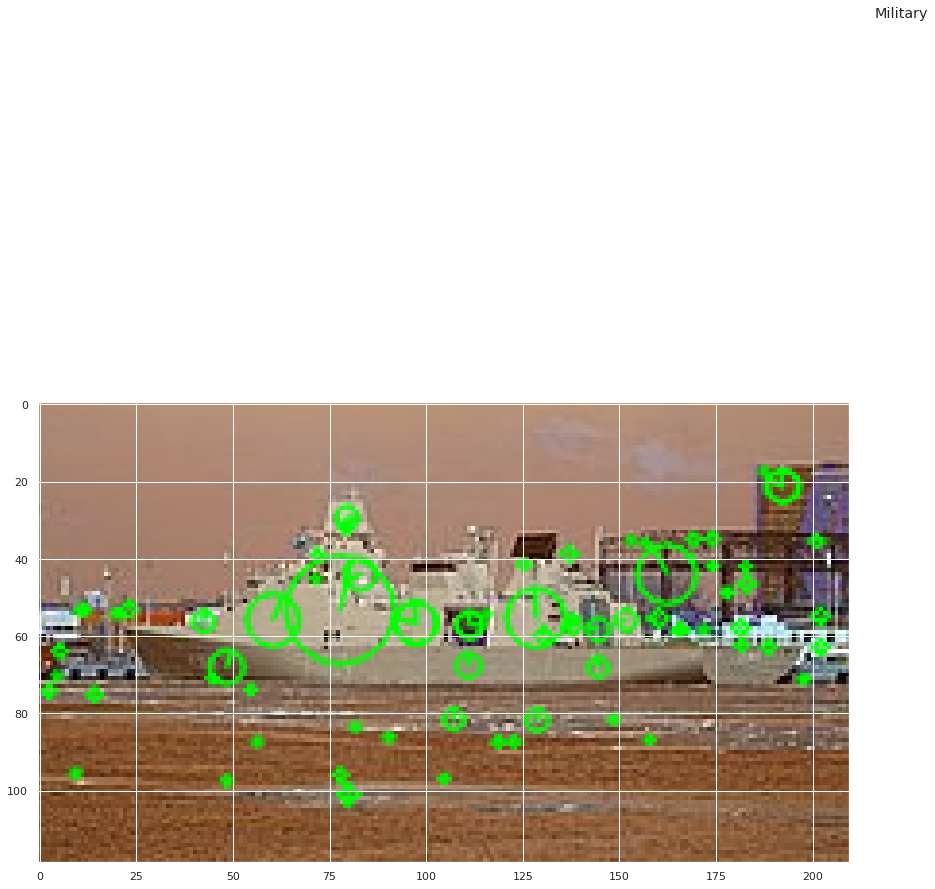

...

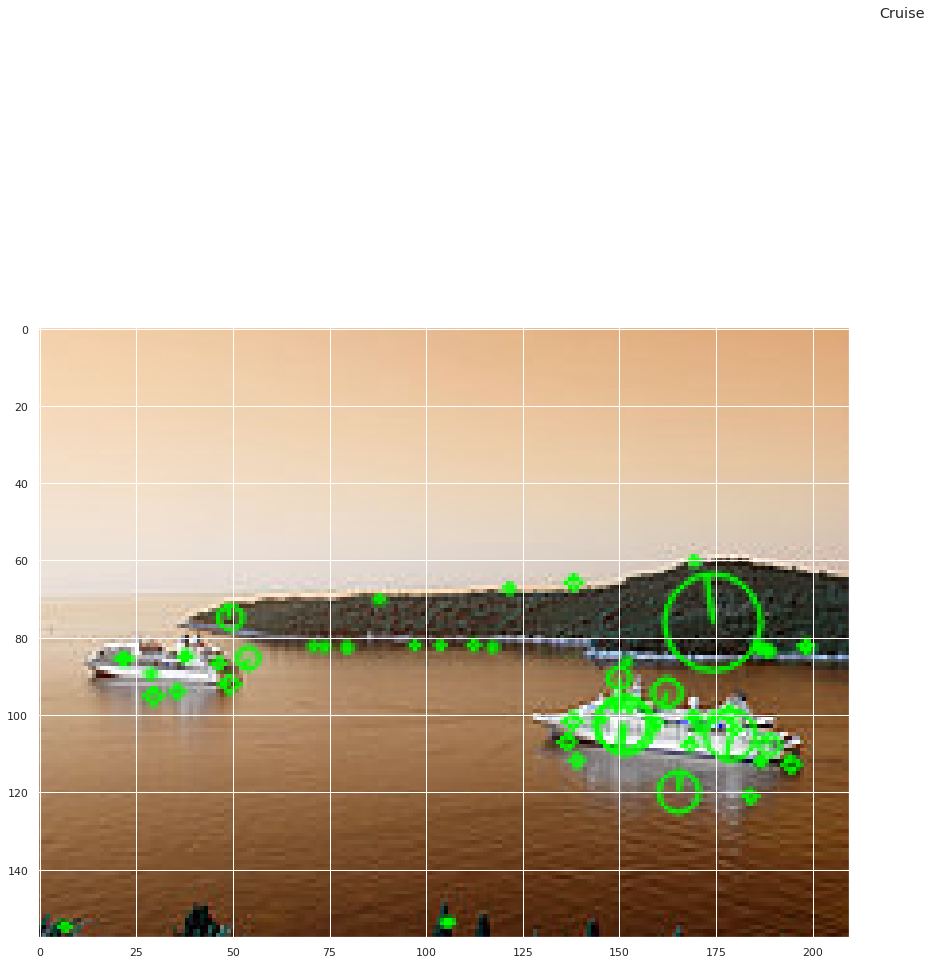

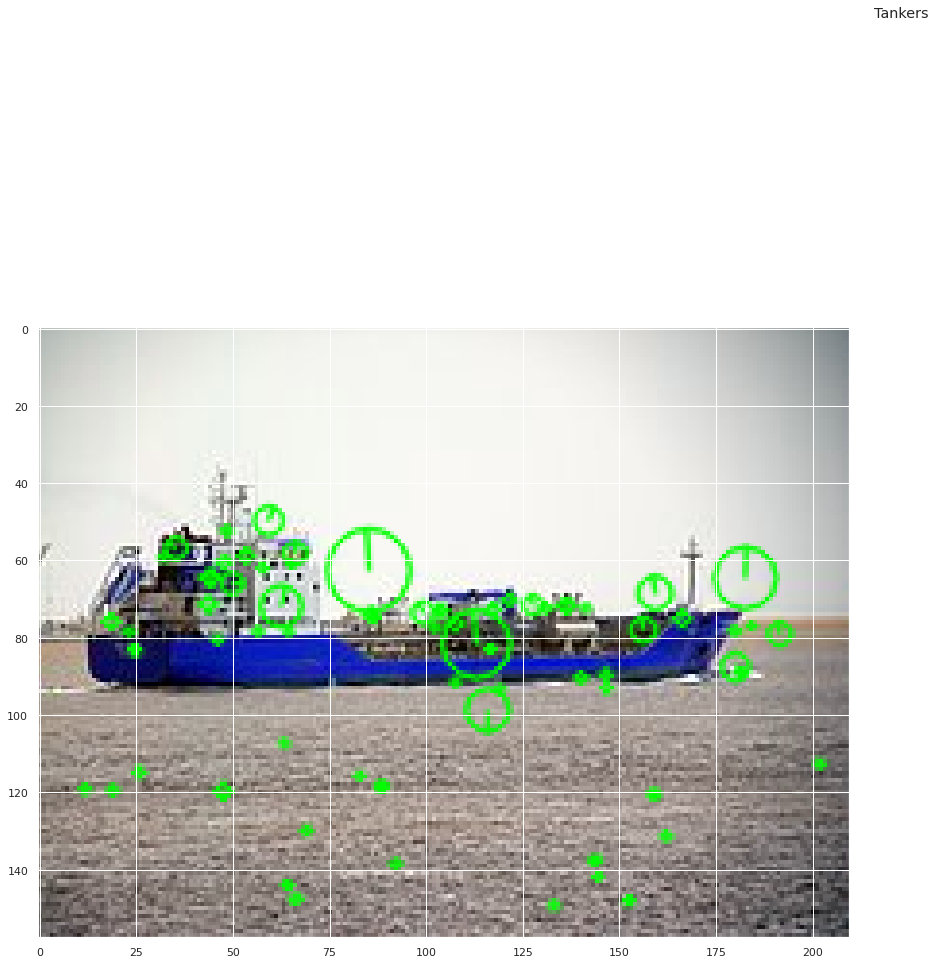

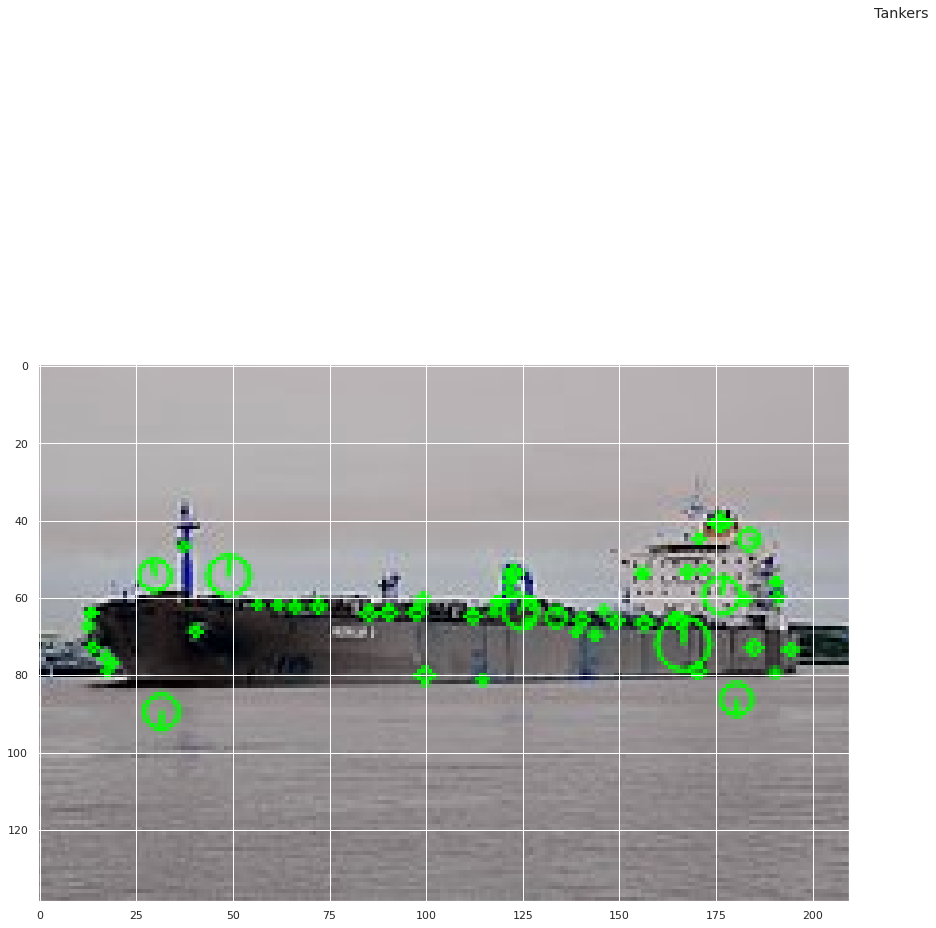

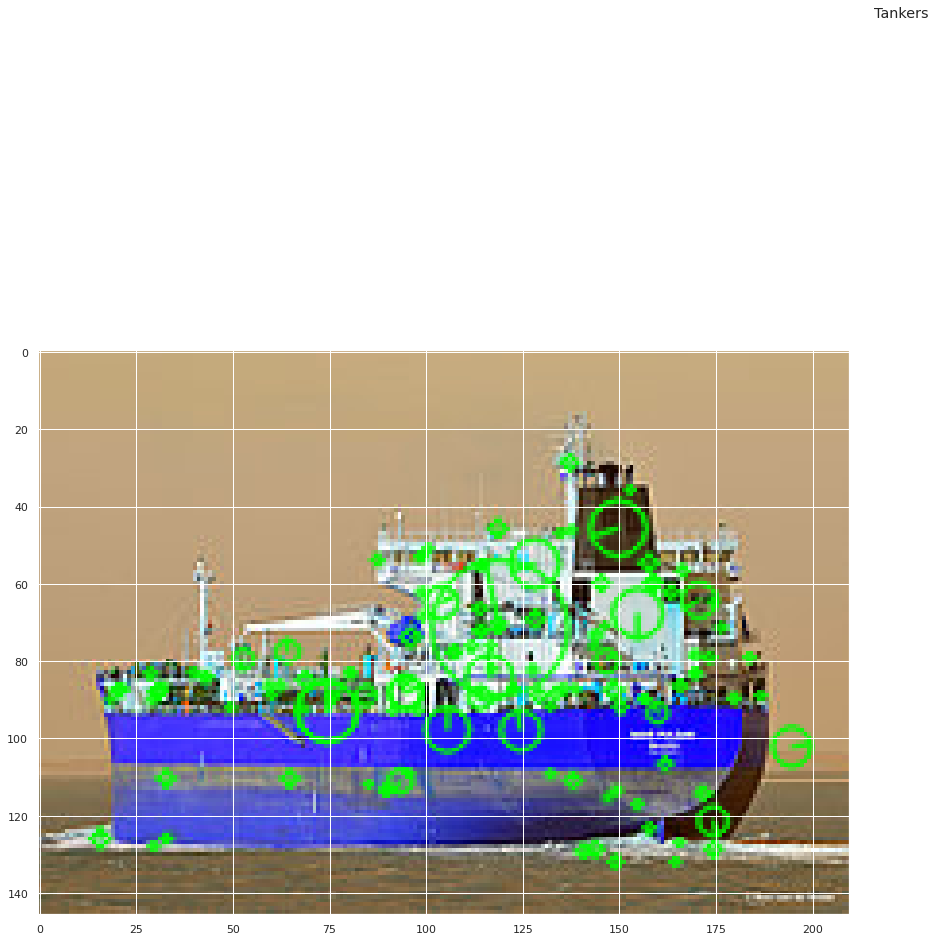

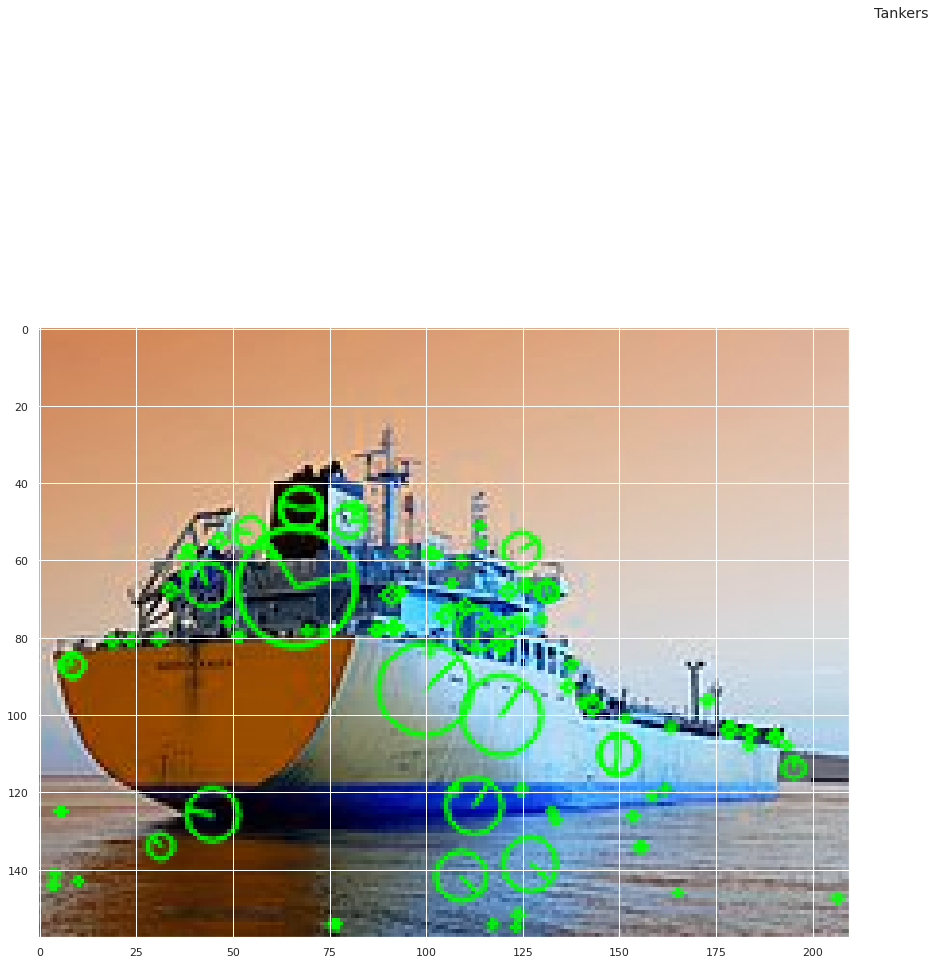

In [36]:
for class_name in main_df['classes'].unique():
    sift_images_gray(class_name)

## HOG

In [37]:
def hog_images(class_name):
    classes_df = main_df[main_df['classes'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        fd, hog_image = hog(image, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True, multichannel=True)
        fig = plt.figure(figsize=(32, 32))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(hog_image, cmap="viridis")
        plt.show()

/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:338: FutureWarning: `multichannel` is a deprecated argument name for `hog`. It will be removed in version 1.0.Please use `channel_axis` instead.
  return func(*args, **kwargs)


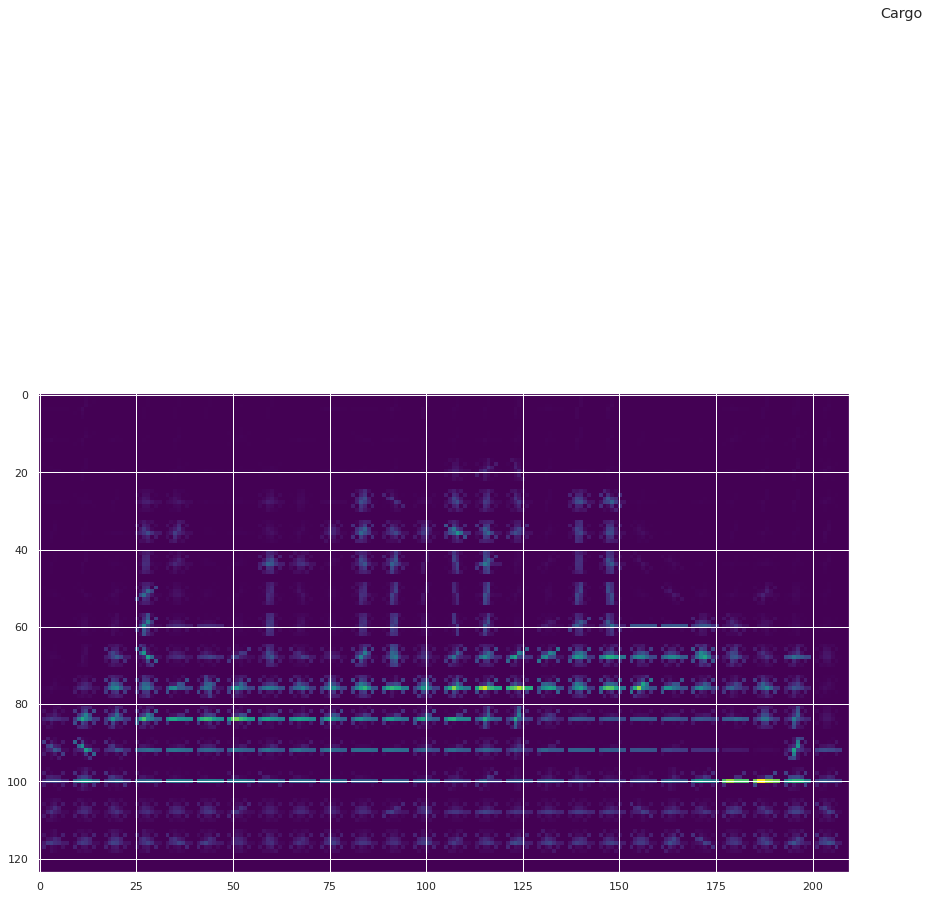

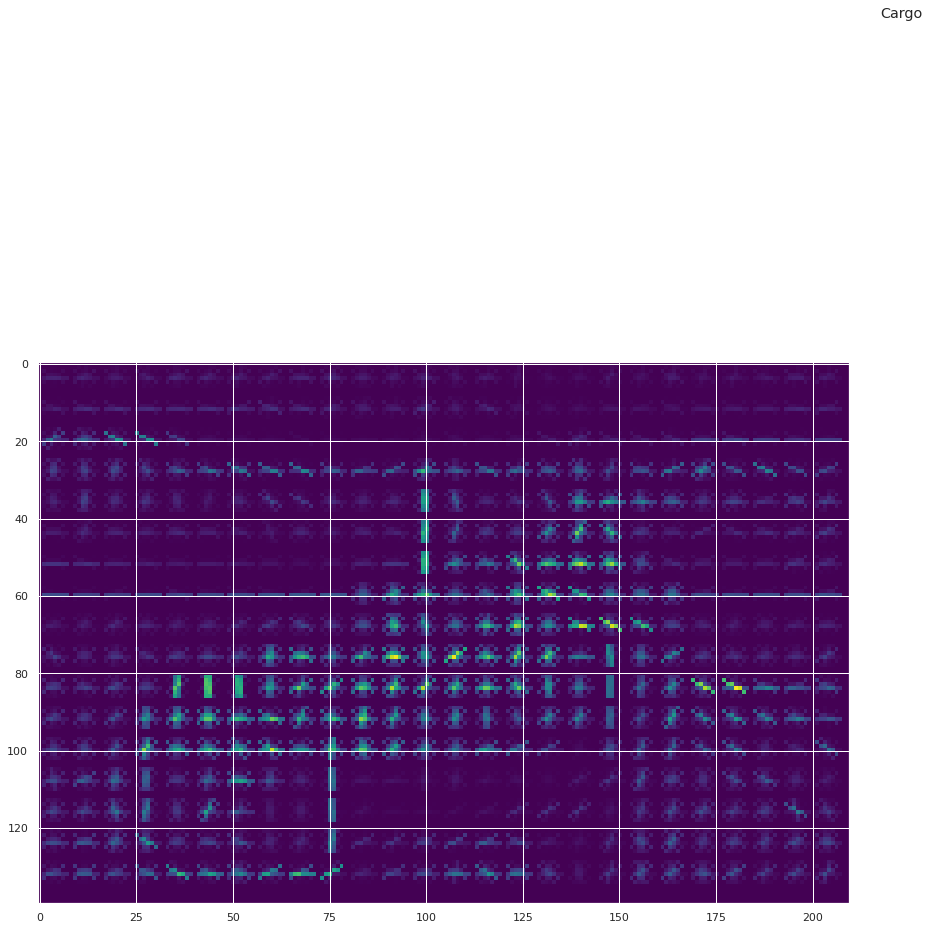

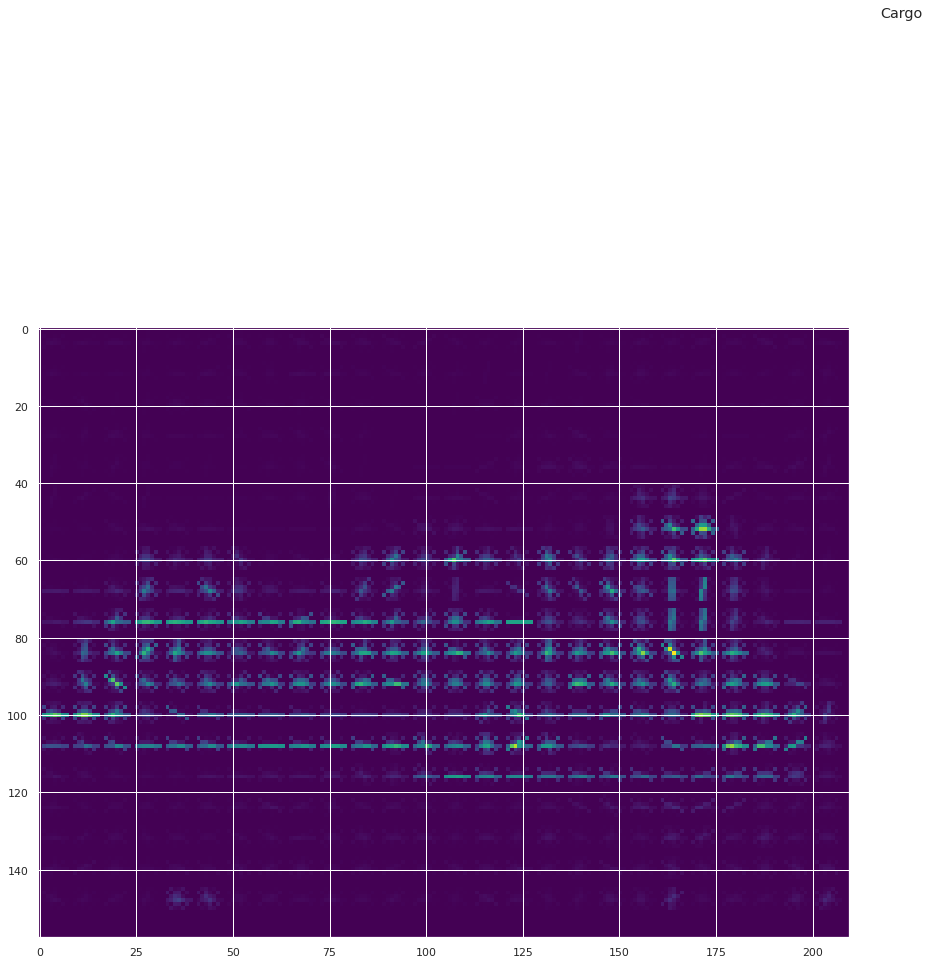

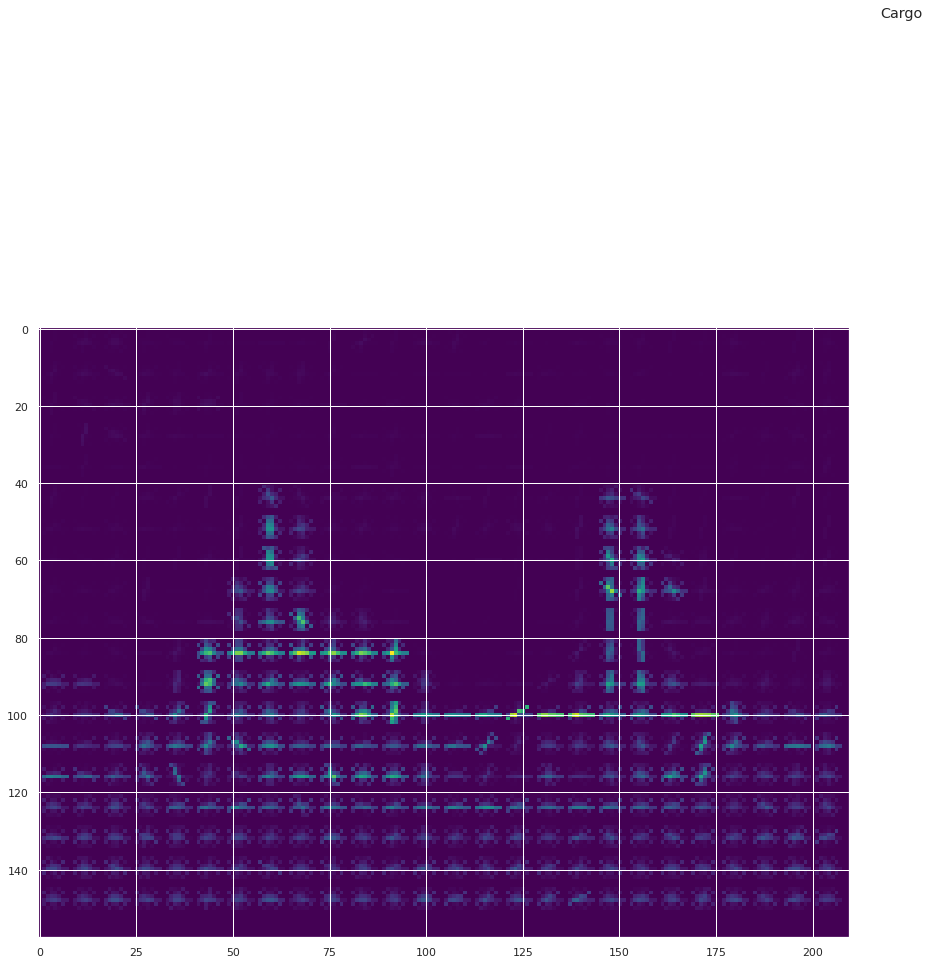

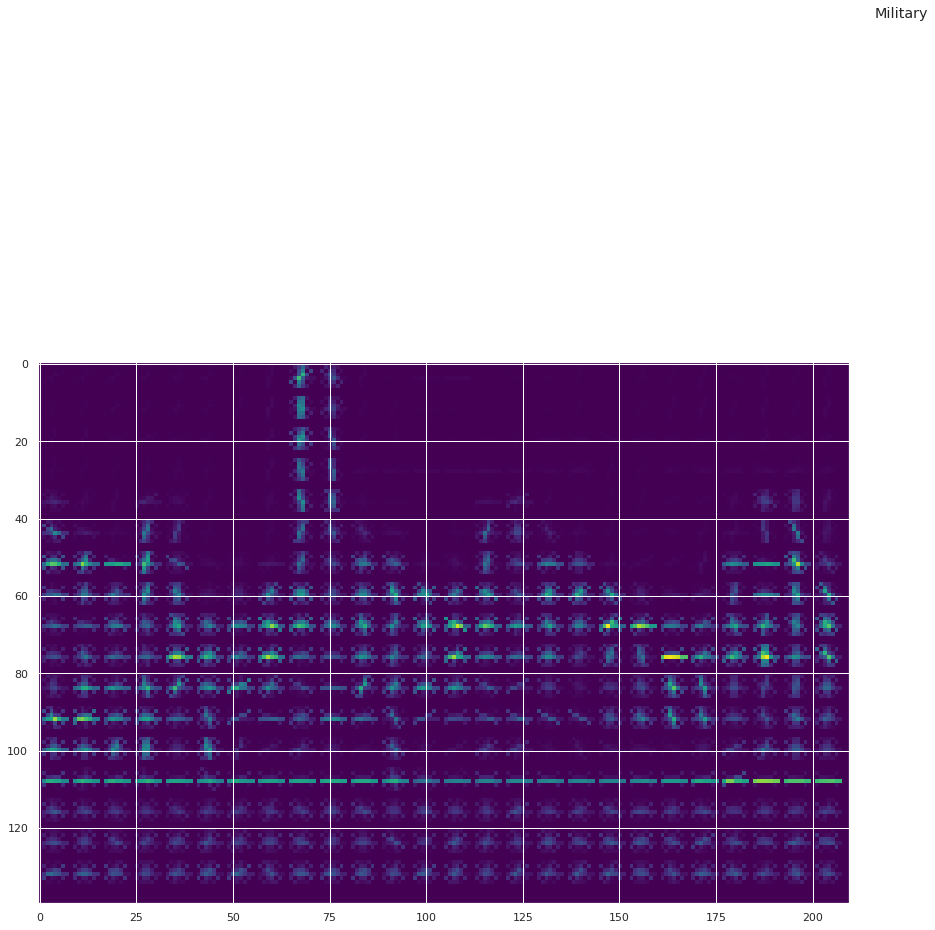

...

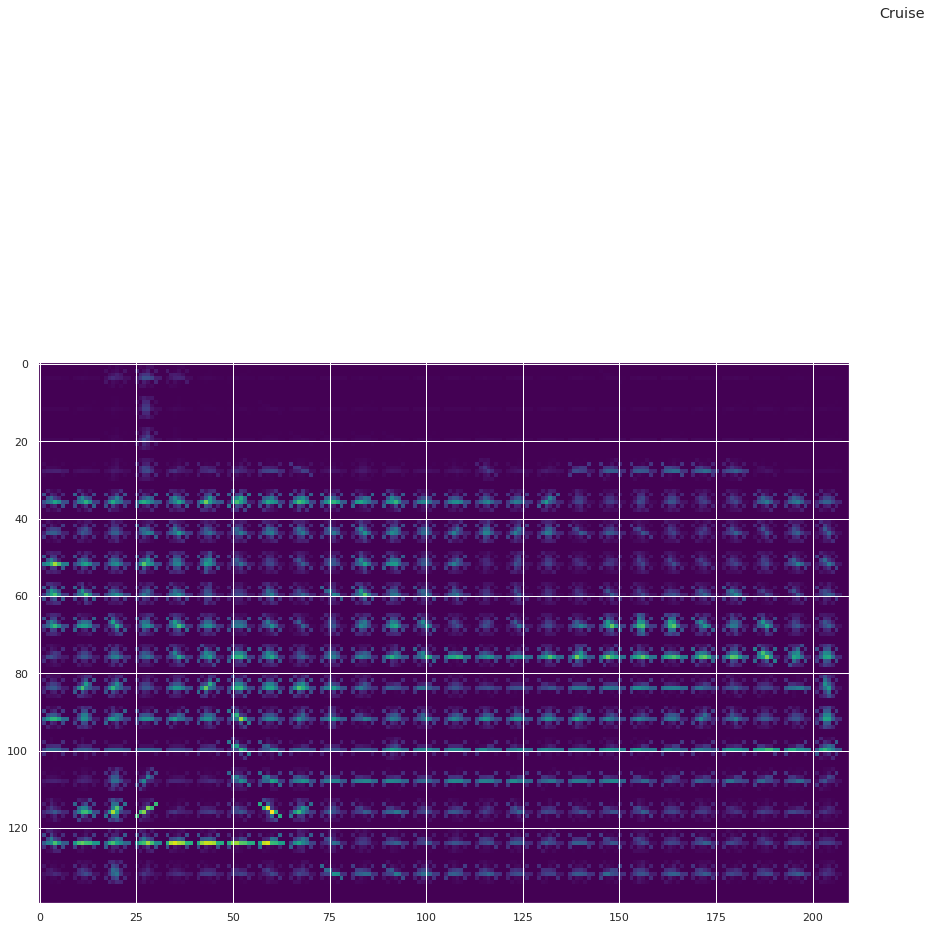

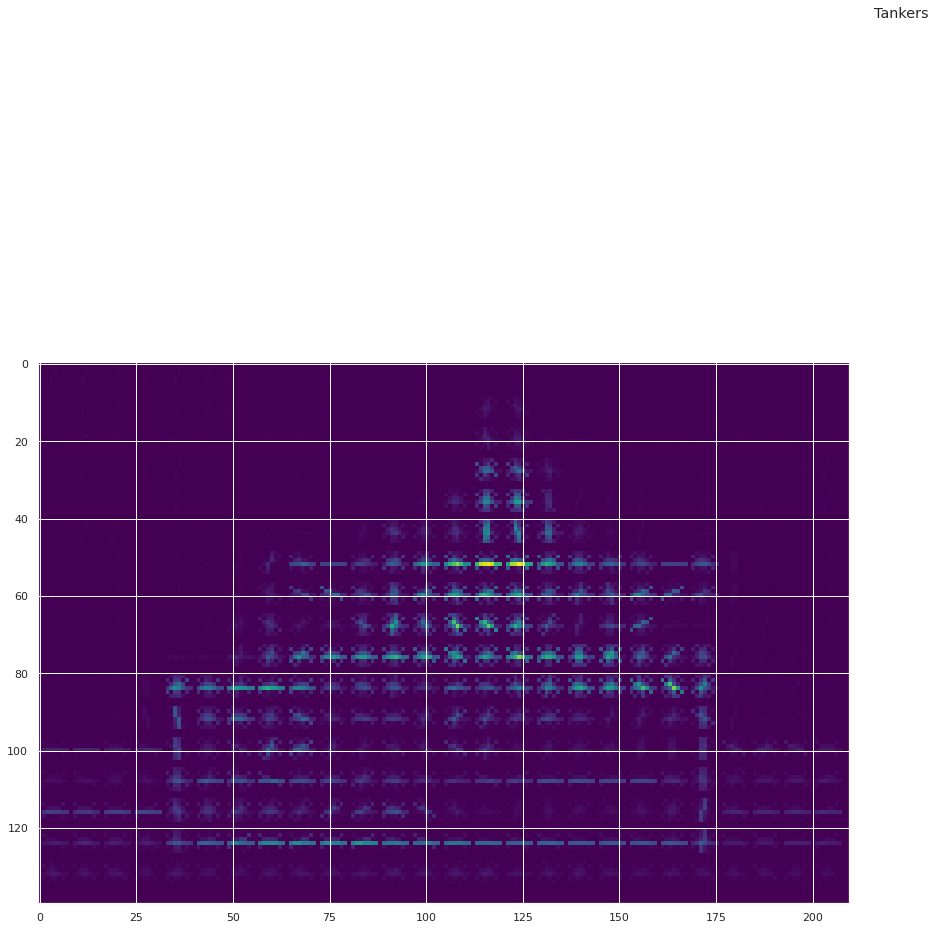

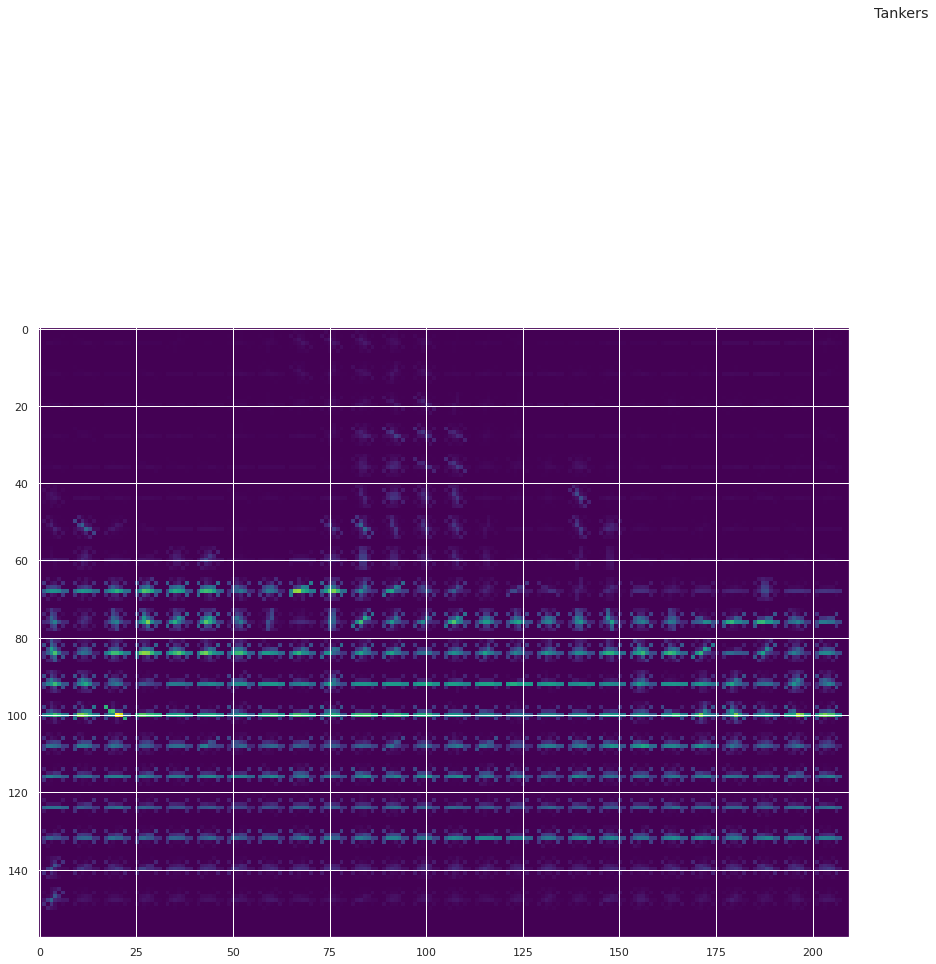

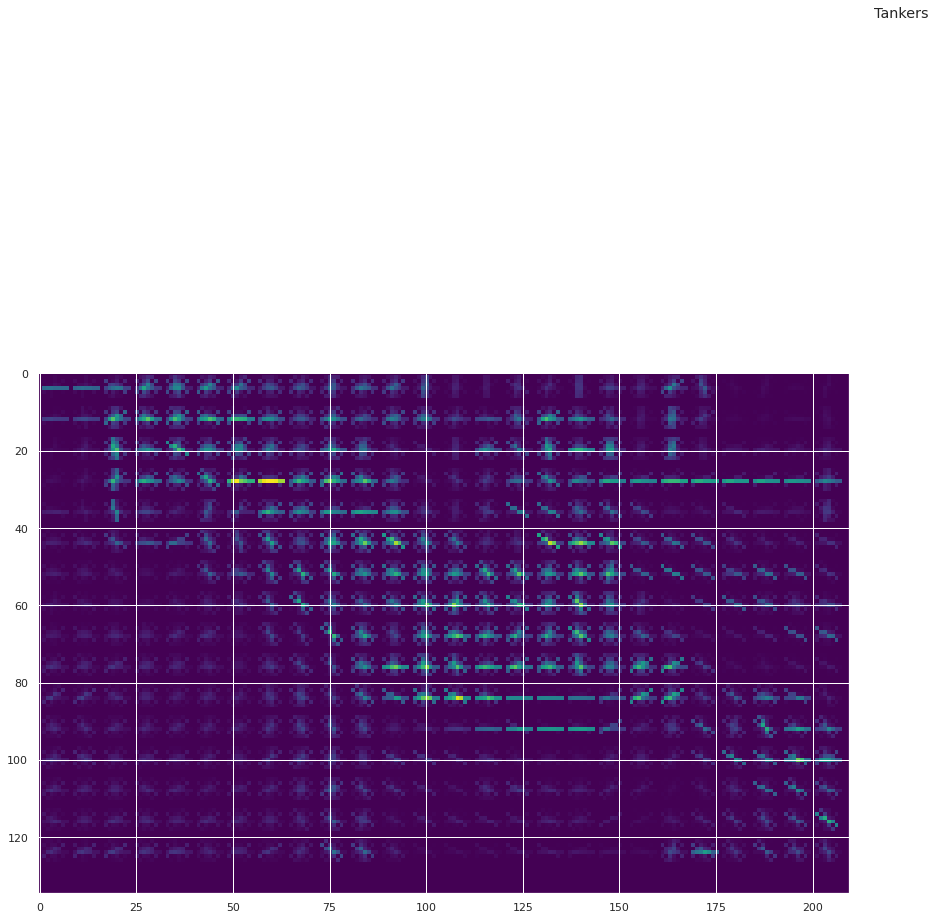

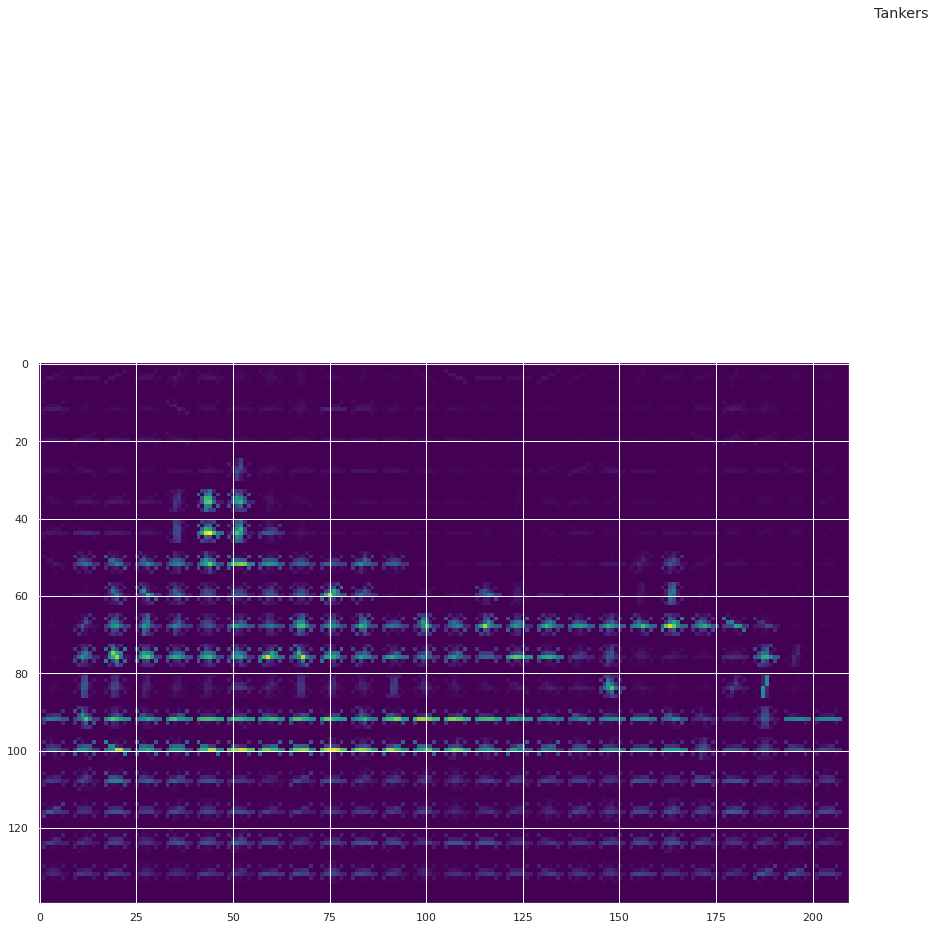

In [38]:
for class_name in main_df['classes'].unique():
    hog_images(class_name)

# Augmentations

In [39]:
def plot_augimages(paths, datagen):
    plt.figure(figsize = (14,28))
    plt.suptitle('Augmented Images')
    
    midx = 0
    for path in paths:
        data = Image.open(path)
        data = data.resize((192,192))
        samples = expand_dims(data, 0)
        it = datagen.flow(samples, batch_size=1)
    
        # Show Original Image
        plt.subplot(10,5, midx+1)
        plt.imshow(data)
        plt.axis('off')
    
        # Show Augmented Images
        for idx, i in enumerate(range(4)):
            midx += 1
            plt.subplot(10,5, midx+1)
            
            batch = it.next()
            image = batch[0].astype('uint8')
            plt.imshow(image)
            plt.axis('off')
        midx += 1
    
    plt.tight_layout()
    plt.show()

## Split X and Y

In [40]:
X, y = main_df[['path', 'classes']], main_df['classes']

In [41]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

## Data Generators

### VGG Generators

In [42]:
from keras.applications.vgg16 import preprocess_input

In [43]:
vgg_datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest',
    preprocessing_function=preprocess_input
) 

train_generator_vgg = vgg_datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(192, 192),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)
val_generator_vgg = vgg_datagen.flow_from_dataframe(
        X_test,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(192, 192),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 5001 validated image filenames belonging to 5 classes.
Found 1251 validated image filenames belonging to 5 classes.


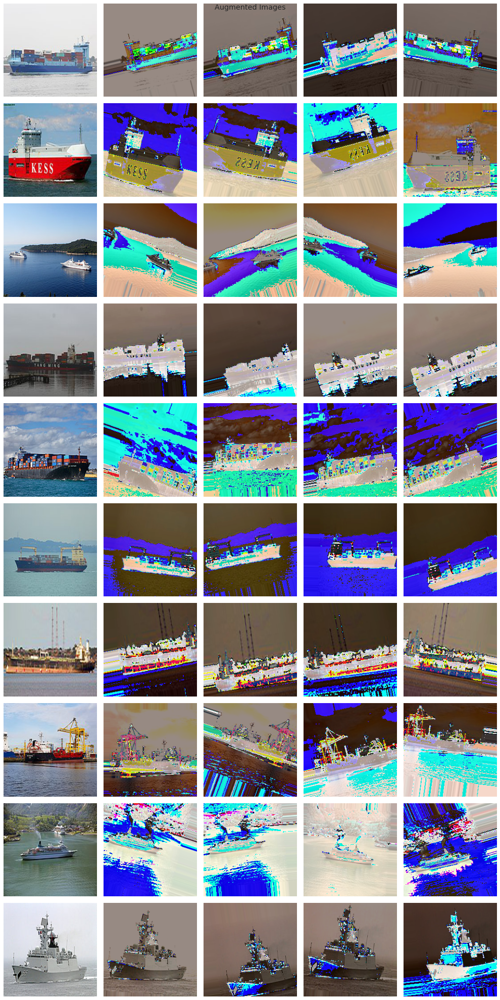

In [44]:
plot_augimages(np.random.choice(main_df['path'],10), vgg_datagen)

## Resnet50 Generators

In [45]:
from tensorflow.keras.applications.resnet50 import preprocess_input

In [46]:
resnet50_datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest',
    preprocessing_function=preprocess_input
) 

train_generator_resnet50 = resnet50_datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(192, 192),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)
val_generator_resnet50 = resnet50_datagen.flow_from_dataframe(
        X_test,  # This is the source directory for training images
        x_col='path',
        y_col='classes',
        target_size=(192, 192),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=True,
)

Found 5001 validated image filenames belonging to 5 classes.
Found 1251 validated image filenames belonging to 5 classes.


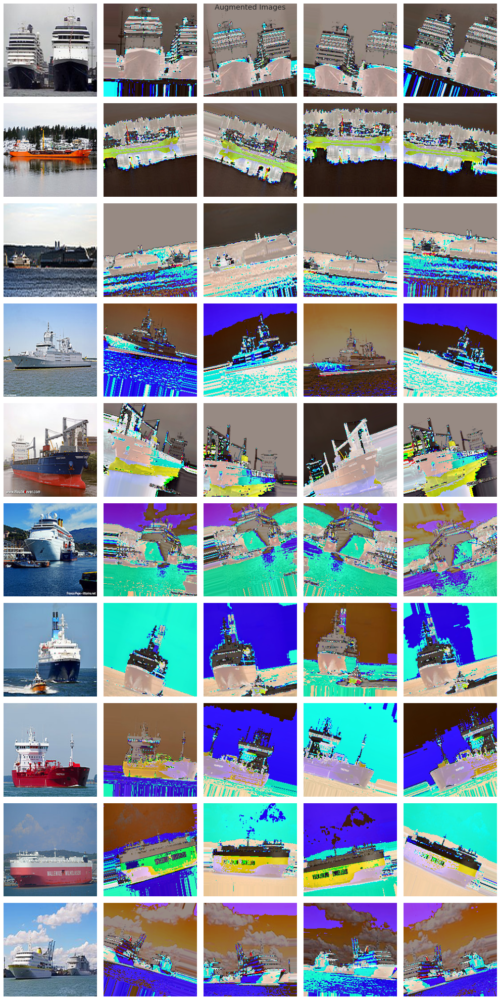

In [47]:
try:
    plot_augimages(np.random.choice(main_df['path'],10), resnet50_datagen)
except:
    print("continue no issues")

# Modelling

In [52]:
resnet50 = ResNet50(include_top = False, input_shape = (192,192,3), weights = 'imagenet')

# training of all the convolution is set to false
for layer in resnet50.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(resnet50.output)
predictions = Dense(5, activation='softmax')(x)

model_resnet50 = Model(inputs = resnet50.input, outputs = predictions)

94781440/94765736 [==============================] - 1s 0us/step


### Resnet Compilation

In [55]:
model_resnet50.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

### Fitting Resnet50

In [ ]:
history_resnet50 = model_resnet50.fit(
      train_generator_resnet50,
      validation_data=val_generator_resnet50,
      epochs=50,
      verbose=2)

### Analyzing perfomance of Resnet50

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_resnet50.history['accuracy'])
plt.plot(history_resnet50.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_resnet50.history['loss'])
plt.plot(history_resnet50.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.show()